<a href="https://colab.research.google.com/github/anandpol98/Image-Denoising-using-DNN/blob/main/image_denoising_residual_learn_batch_n1_sigma50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing required libraries

In [ ]:
import argparse
import re
import os, time, datetime
#import PIL.Image as Image
import numpy as np
from skimage import img_as_ubyte
from keras.models import load_model, model_from_json
from skimage.metrics import peak_signal_noise_ratio,structural_similarity
#from google.colab.patches import cv2_imshow
from skimage.io import imread, imsave
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage import img_as_ubyte
import os, glob, datetime
from keras.layers import  Input,Conv2D,BatchNormalization,Activation,Subtract
from keras.models import Model, load_model
from keras.callbacks import CSVLogger, ModelCheckpoint, LearningRateScheduler
from keras.optimizers import Adam
#import data_generator as dg
import keras.backend as K

# Preprocessing Training data

In [ ]:
import glob
import os
import cv2
import numpy as np
#from multiprocessing import Pool


patch_size, stride = 40, 10
aug_times = 1
scales = [1, 0.9, 0.8, 0.7]
batch_size = 128


def show(x,title=None,cbar=False,figsize=None):
    import matplotlib.pyplot as plt
    plt.figure(figsize=figsize)
    plt.imshow(x,interpolation='INTER_CUBIC',cmap='gray')
    if title:
        plt.title(title)
    if cbar:
        plt.colorbar()
    plt.show()

def data_aug(img, mode=0):

    if mode == 0:
        return img
    elif mode == 1:
        return np.flipud(img)
    elif mode == 2:
        return np.rot90(img)
    elif mode == 3:
        return np.flipud(np.rot90(img))
    elif mode == 4:
        return np.rot90(img, k=2)
    elif mode == 5:
        return np.flipud(np.rot90(img, k=2))
    elif mode == 6:
        return np.rot90(img, k=3)
    elif mode == 7:
        return np.flipud(np.rot90(img, k=3))

def gen_patches(file_name):

    # read image
    img = cv2.imread(file_name, 0)  # gray scale
    h, w = img.shape
    patches = []
    for s in scales:
        h_scaled, w_scaled = int(h*s),int(w*s)
        img_scaled = cv2.resize(img, (h_scaled,w_scaled), interpolation=cv2.INTER_CUBIC)
        # extract patches
        for i in range(0, h_scaled-patch_size+1, stride):
            for j in range(0, w_scaled-patch_size+1, stride):
                x = img_scaled[i:i+patch_size, j:j+patch_size]
                #patches.append(x)        
                # data aug
                for k in range(0, aug_times):
                    x_aug = data_aug(x, mode=np.random.randint(0,8))
                    patches.append(x_aug)
                
    return patches

def datagenerator(data_dir='../input/image-data/Train400/Train400',verbose=False):
    
    file_list = glob.glob(data_dir+'/*.png')  # get name list of all .png files
    # initrialize
    data = []
    # generate patches
    for i in range(len(file_list)):
        patch = gen_patches(file_list[i])
        data.append(patch)
        if verbose:
            print(str(i+1)+'/'+ str(len(file_list)) + ' is done ^_^')
    data = np.array(data, dtype='uint8')
    data = data.reshape((data.shape[0]*data.shape[1],data.shape[2],data.shape[3],1))
    discard_n = len(data)-len(data)//batch_size*batch_size;
    data = np.delete(data,range(discard_n),axis = 0)
    print('Training data finished-Good to go!')
    return data


data = datagenerator(data_dir='../input/image-data/Train400/Train400')

Training data finished-Good to go!


# Training Phase

In [ ]:

# run this to train the model

# =============================================================================
# For batch normalization layer, momentum should be a value from [0, 0.9] rather than the default 0.99. 
# The Gaussian noise output helps to stablize the batch normalization, thus a small momentum is preferred.
# =============================================================================


## Params
parser = argparse.ArgumentParser()
parser.add_argument('--model', default='DnCNN', type=str, help='choose a type of model')
parser.add_argument('--batch_size', default=128, type=int, help='batch size')
parser.add_argument('--train_data', default='../input/image-data/Train400/Train400', type=str, help='path of train data')
parser.add_argument('--sigma', default=50, type=int, help='noise level')

# epochs = 300 changed to 50
#parser.add_argument('--epoch', default=300, type=int, help='number of train epoches')
parser.add_argument('--epoch', default=50, type=int, help='number of train epoches')


parser.add_argument('--lr', default=1e-3, type=float, help='initial learning rate for Adam')

parser.add_argument('--save_every', default=500, type=int, help='save model at every x epoches')
args = parser.parse_args(args=[])


save_dir = os.path.join('./','models',args.model+'_'+'sigma'+str(args.sigma)) 

if not os.path.exists(save_dir):
  os.makedirs(save_dir)

# DnCNN model

In [ ]:
def DnCNN(depth,filters=64,image_channels=1, use_bnorm=True):
    layer_count = 0
    inpt = Input(shape=(None,None,image_channels),name = 'input'+str(layer_count))
    # 1st layer, Conv+relu
    layer_count += 1
    x = Conv2D(filters=filters, kernel_size=(3,3), strides=(1,1),kernel_initializer='Orthogonal', padding='same',name = 'conv'+str(layer_count))(inpt)
    layer_count += 1
    x = Activation('relu',name = 'relu'+str(layer_count))(x)
    # depth-2 layers, Conv+BN+relu
    for i in range(depth-2):
      layer_count += 1
      x = Conv2D(filters=filters, kernel_size=(3,3), strides=(1,1),kernel_initializer='Orthogonal', padding='same',use_bias = False,name = 'conv'+str(layer_count))(x)
      if use_bnorm:
        layer_count += 1
        
        # momentum changed to 0.9 from 0.0
        #x = BatchNormalization(axis=3, momentum=0.1,epsilon=0.0001, name = 'bn'+str(layer_count))(x) 
        #x = BatchNormalization(axis=3, momentum=0.0,epsilon=0.0001, name = 'bn'+str(layer_count))(x)
        x = BatchNormalization(axis=3, momentum=0.9,epsilon=0.0001, name = 'bn'+str(layer_count))(x)
          
      layer_count += 1
      x = Activation('relu',name = 'relu'+str(layer_count))(x)  
    # last layer, Conv
    layer_count += 1
    x = Conv2D(filters=image_channels, kernel_size=(3,3), strides=(1,1), kernel_initializer='Orthogonal',padding='same',use_bias = False,name = 'conv'+str(layer_count))(x)
    layer_count += 1
    x = Subtract(name = 'subtract' + str(layer_count))([inpt, x])   # input - noise
    model = Model(inputs=inpt, outputs=x)
    
    return model

# Load model from last Checkpoint

In [ ]:
def findLastCheckpoint(save_dir):
    file_list = glob.glob(os.path.join(save_dir,'model_*.hdf5'))  # get name list of all .hdf5 files
    #file_list = os.listdir(save_dir)
    if file_list:
        epochs_exist = []
        for file_ in file_list:
            result = re.findall(".*model_(.*).hdf5.*",file_)
            #print(result[0])
            epochs_exist.append(int(result[0]))
        initial_epoch=max(epochs_exist)   
    else:
        initial_epoch = 0
    return initial_epoch

# Learning rate, log file, train data generation

In [ ]:
def log(*args,**kwargs):
     print(datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S:"),*args,**kwargs)

def lr_schedule(epoch):
    initial_lr = args.lr
    if epoch<=30:
        lr = initial_lr
    elif epoch<=60:
        lr = initial_lr/10
    elif epoch<=80:
        lr = initial_lr/20 
    else:
        lr = initial_lr/20 
    log('current learning rate is %2.8f' %lr)
    return lr

def train_datagen(epoch_iter=2000,epoch_num=5,batch_size=128,data_dir=args.train_data):
    while(True):
        n_count = 0
        if n_count == 0:
            #print(n_count)
            xs = datagenerator(data_dir)
            assert len(xs)%args.batch_size ==0, \
            log('make sure the last iteration has a full batchsize, this is important if you use batch normalization!')
            xs = xs.astype('float32')/255.0
            indices = list(range(xs.shape[0]))
            n_count = 1
        for _ in range(epoch_num):
            np.random.shuffle(indices)    # shuffle
            for i in range(0, len(indices), batch_size):
                batch_x = xs[indices[i:i+batch_size]]
                noise =  np.random.normal(0, args.sigma/255.0, batch_x.shape)    # noise
                #noise =  K.random_normal(ge_batch_y.shape, mean=0, stddev=args.sigma/255.0)
                batch_y = batch_x + noise 
                yield batch_y, batch_x

# Loss Function

In [ ]:
# define loss
def sum_squared_error(y_true, y_pred):
    #return K.mean(K.square(y_pred - y_true), axis=-1)
    #return K.sum(K.square(y_pred - y_true), axis=-1)/2
    return K.sum(K.square(y_pred - y_true))/2

# Model Summary

In [ ]:
# model selection
model = DnCNN(depth=17,filters=64,image_channels=1,use_bnorm=True)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input0 (InputLayer)             [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 640         input0[0][0]                     
__________________________________________________________________________________________________
relu2 (Activation)              (None, None, None, 6 0           conv1[0][0]                      
__________________________________________________________________________________________________
conv3 (Conv2D)                  (None, None, None, 6 36864       relu2[0][0]                      
______________________________________________________________________________________________

In [ ]:
# load the last model in matconvnet style
initial_epoch = findLastCheckpoint(save_dir=save_dir)
if initial_epoch > 0:  
    print('resuming by loading epoch %03d'%initial_epoch)
    model = load_model(os.path.join(save_dir,'model_%03d.hdf5'%initial_epoch), compile=False)

# compile the model
model.compile(optimizer=Adam(0.001), loss=sum_squared_error)

# use call back functions
checkpointer = ModelCheckpoint(os.path.join(save_dir,'model_{epoch:03d}.hdf5'), 
            verbose=1, save_weights_only=False, save_freq=args.save_every)
csv_logger = CSVLogger(os.path.join(save_dir,'log.csv'), append=True, separator=',')
lr_scheduler = LearningRateScheduler(lr_schedule)

history = model.fit(train_datagen(batch_size=args.batch_size),
            steps_per_epoch=2000, epochs=args.epoch, verbose=1, initial_epoch=initial_epoch,
            callbacks=[checkpointer,csv_logger,lr_scheduler])

Training data finished-Good to go!
Epoch 1/50
2021-05-08 04:31:53: current learning rate is 0.00100000
 500/2000 [======>.......................] - ETA: 3:08 - loss: 4686.3750
Epoch 00001: saving model to ./models/DnCNN_sigma50/model_001.hdf5
1000/2000 [==============>...............] - ETA: 2:05 - loss: 3037.6308
Epoch 00001: saving model to ./models/DnCNN_sigma50/model_001.hdf5
1500/2000 [=====================>........] - ETA: 1:02 - loss: 2368.0045
Epoch 00001: saving model to ./models/DnCNN_sigma50/model_001.hdf5
2000/2000 [==============================] - ETA: 0s - loss: 1993.0025
Epoch 00001: saving model to ./models/DnCNN_sigma50/model_001.hdf5
2000/2000 [==============================] - 258s 126ms/step - loss: 1992.4133
Epoch 2/50
2021-05-08 04:36:11: current learning rate is 0.00100000
 500/2000 [======>.......................] - ETA: 3:08 - loss: 439.7587
Epoch 00002: saving model to ./models/DnCNN_sigma50/model_002.hdf5
1000/2000 [==============>...............] - ETA: 2:0

# Resuming Training

In [ ]:
# load the last model in matconvnet style
initial_epoch = findLastCheckpoint(save_dir=save_dir)
if initial_epoch > 0:  
    print('resuming by loading epoch %03d'%initial_epoch)
    model = load_model(os.path.join(save_dir,'model_%03d.hdf5'%initial_epoch), compile=False)

# compile the model
model.compile(optimizer=Adam(0.001), loss=sum_squared_error)

# use call back functions
checkpointer = ModelCheckpoint(os.path.join(save_dir,'model_{epoch:03d}.hdf5'), 
            verbose=1, save_weights_only=False, save_freq=args.save_every)
csv_logger = CSVLogger(os.path.join(save_dir,'log.csv'), append=True, separator=',')
lr_scheduler = LearningRateScheduler(lr_schedule)

history = model.fit(train_datagen(batch_size=args.batch_size),
            steps_per_epoch=2000, epochs=args.epoch, verbose=1, initial_epoch=initial_epoch,
            callbacks=[checkpointer,csv_logger,lr_scheduler])

# Testing phase

2021-05-08 08:06:59: load trained model
     Set68 : test002.png : 0.4390 second


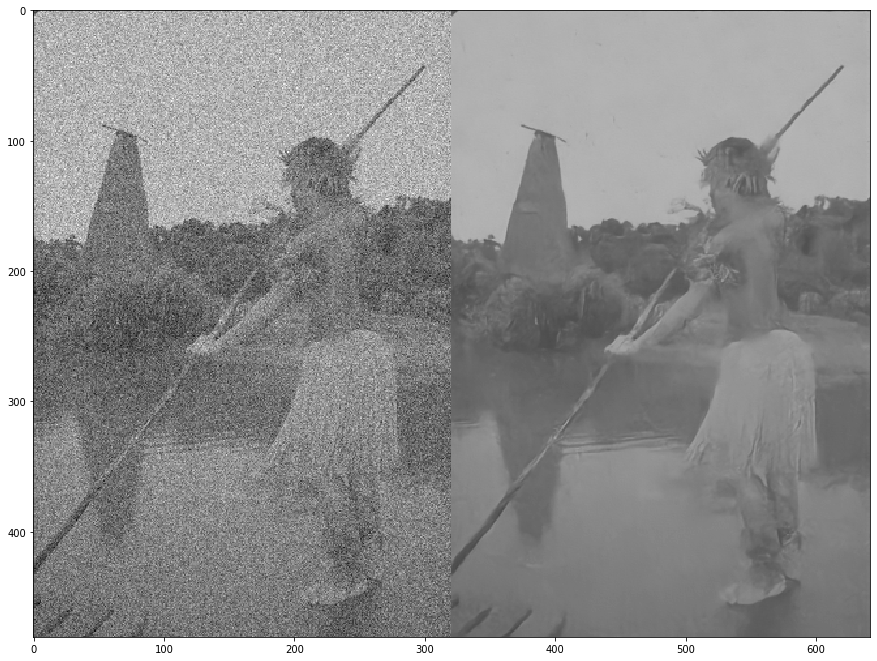

     Set68 : test034.png : 0.0609 second


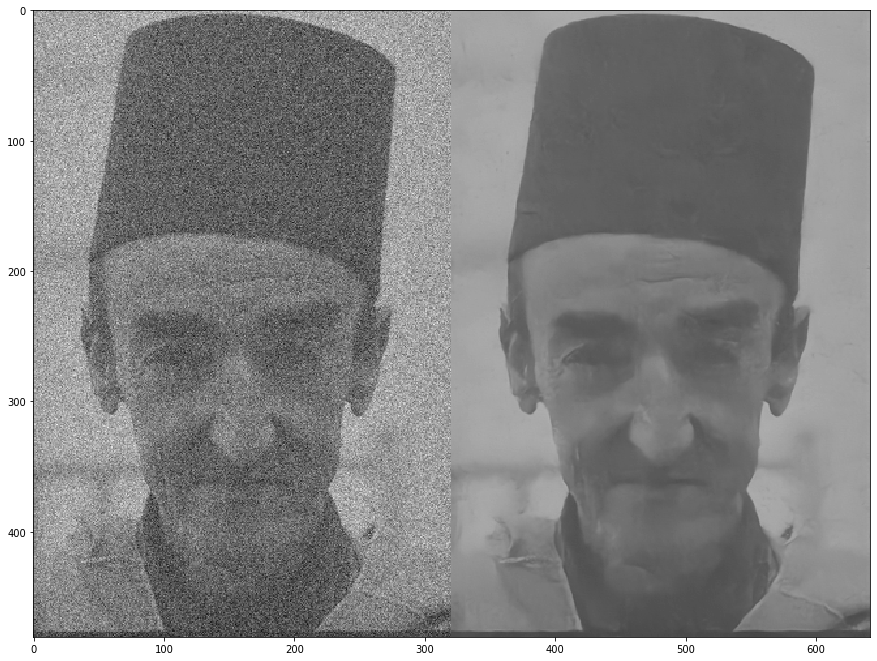

     Set68 : test062.png : 0.0611 second


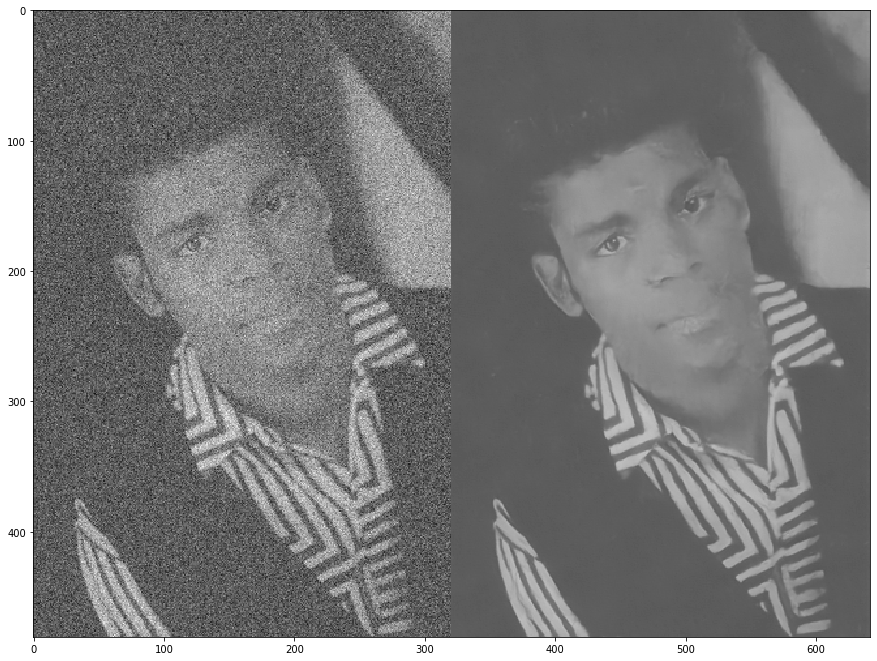

     Set68 : test060.png : 0.3687 second


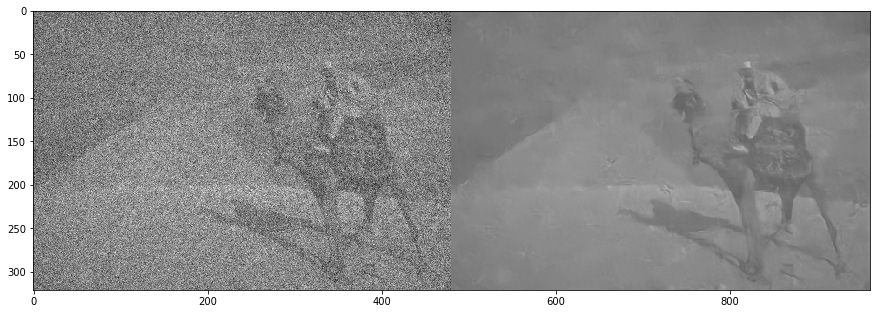

     Set68 : test009.png : 0.0622 second


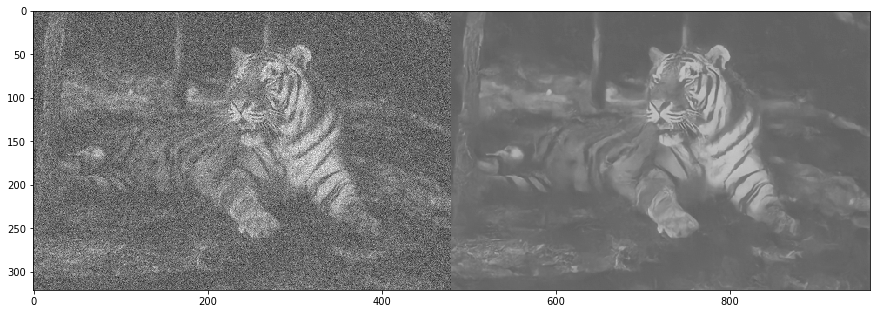

     Set68 : test010.png : 0.0619 second


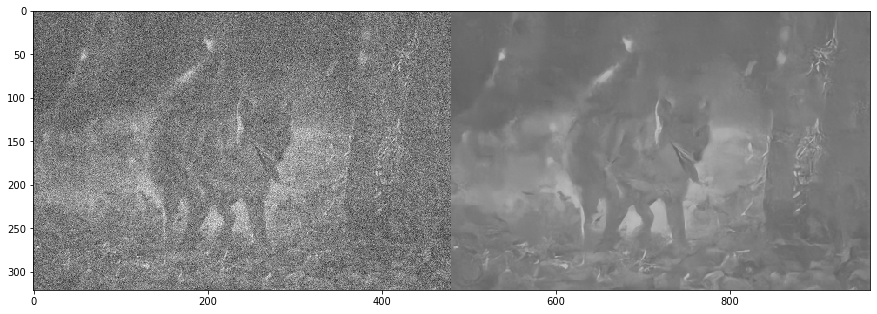

     Set68 : test012.png : 0.0605 second


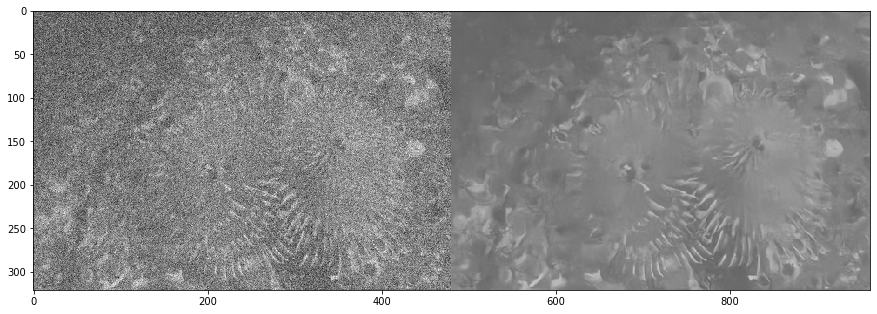

     Set68 : test025.png : 0.0601 second


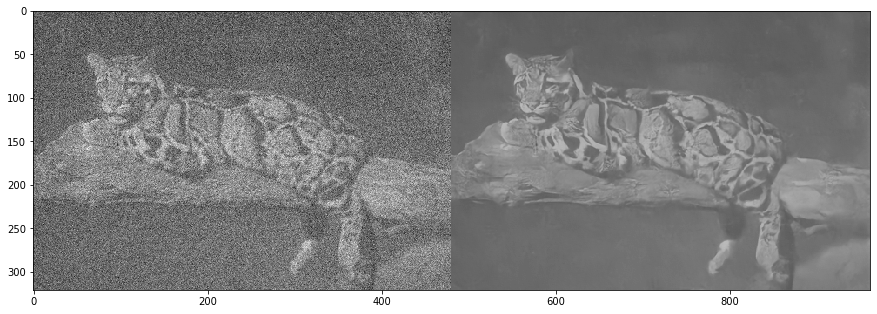

     Set68 : test017.png : 0.0597 second


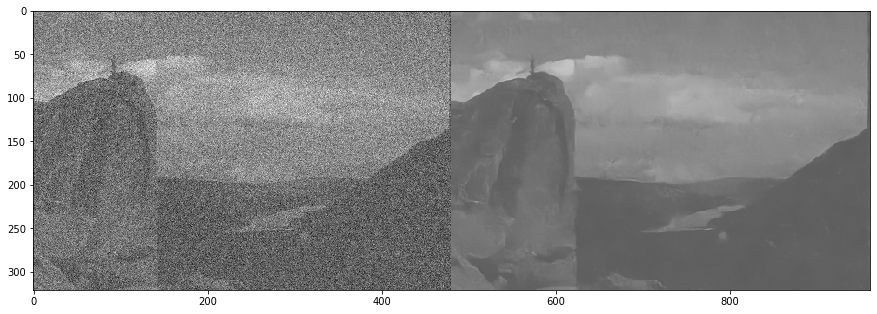

     Set68 : test052.png : 0.0593 second


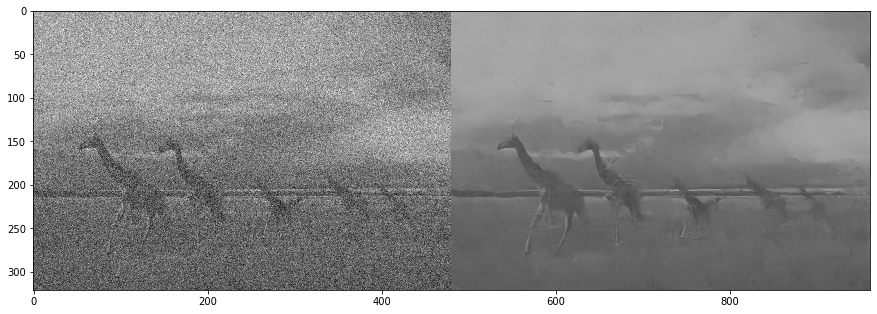

     Set68 : test031.png : 0.0769 second


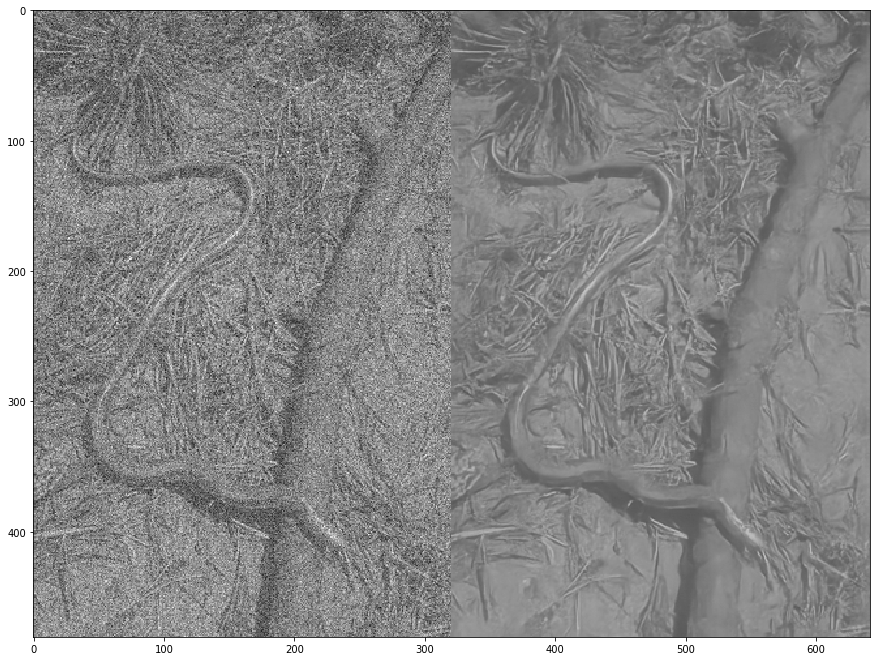

     Set68 : test027.png : 0.0626 second


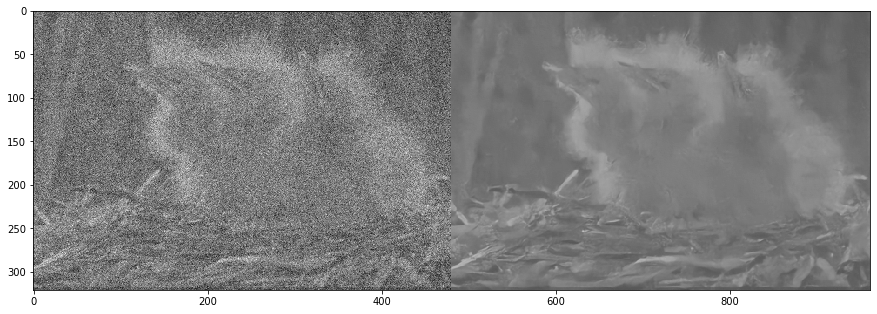

     Set68 : test049.png : 0.0604 second


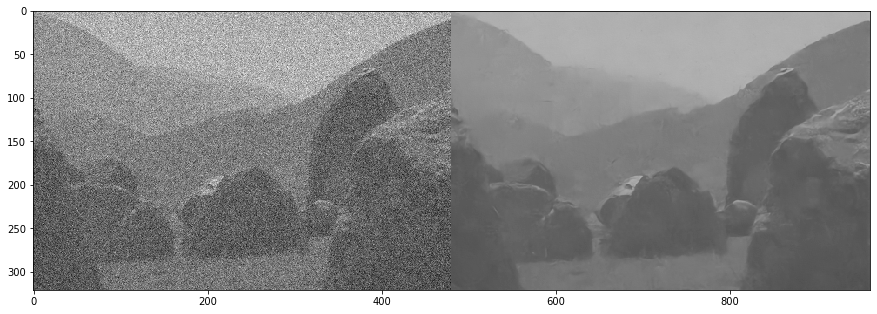

     Set68 : test032.png : 0.0624 second


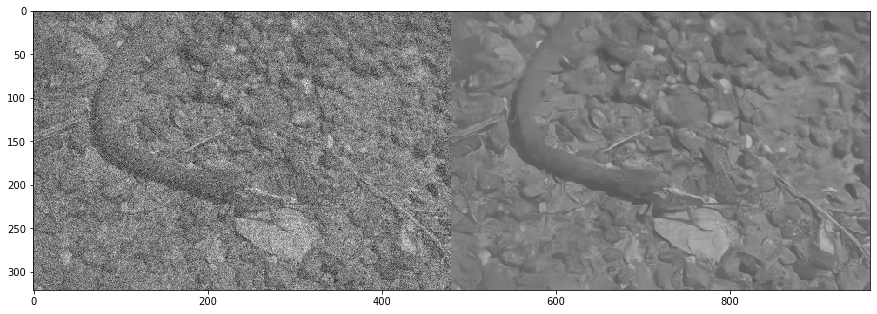

     Set68 : test006.png : 0.0612 second


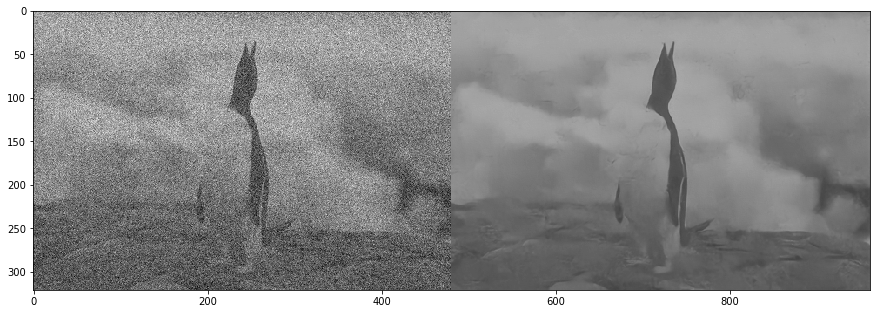

     Set68 : test021.png : 0.0624 second


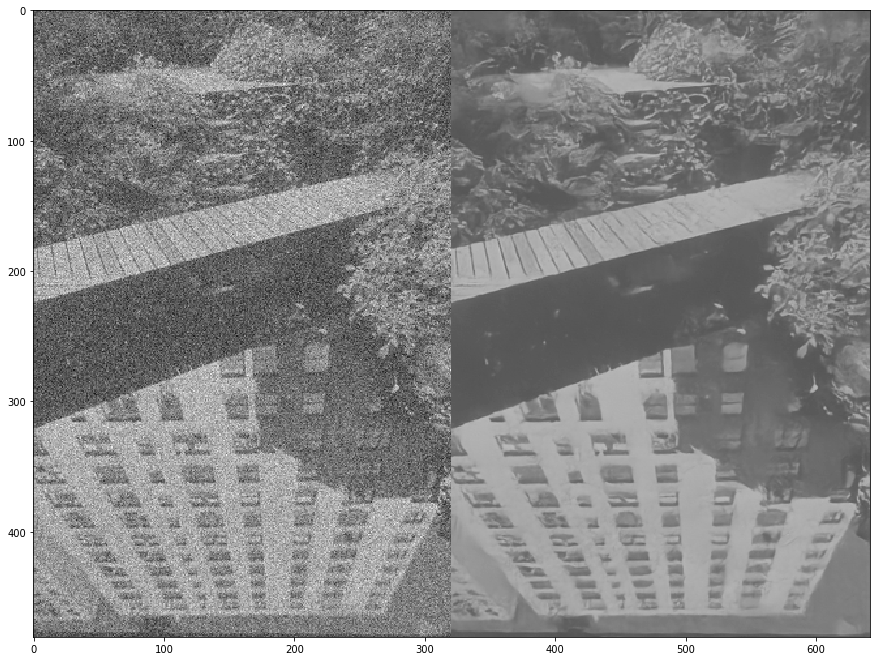

     Set68 : test045.png : 0.0615 second


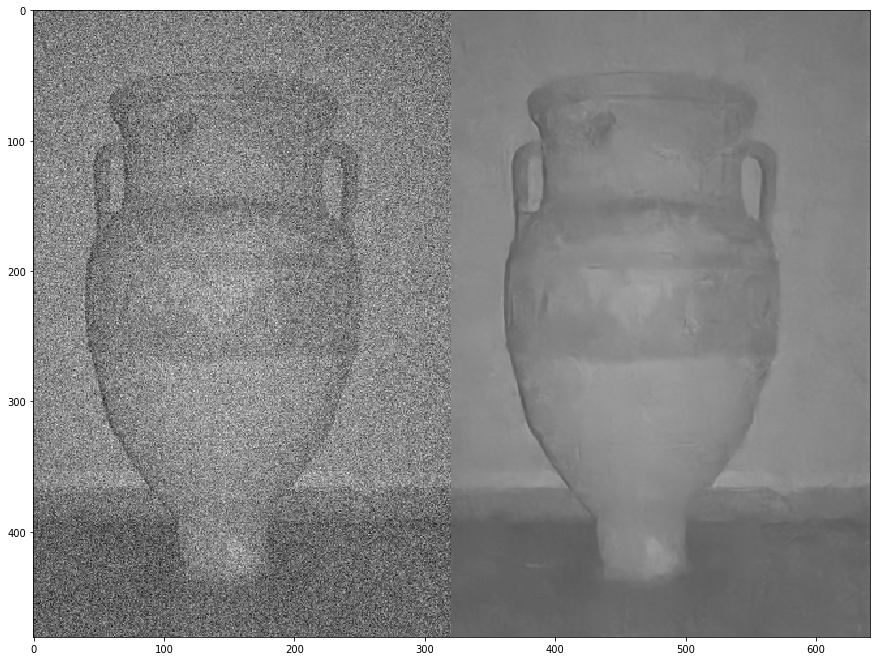

     Set68 : test035.png : 0.2919 second


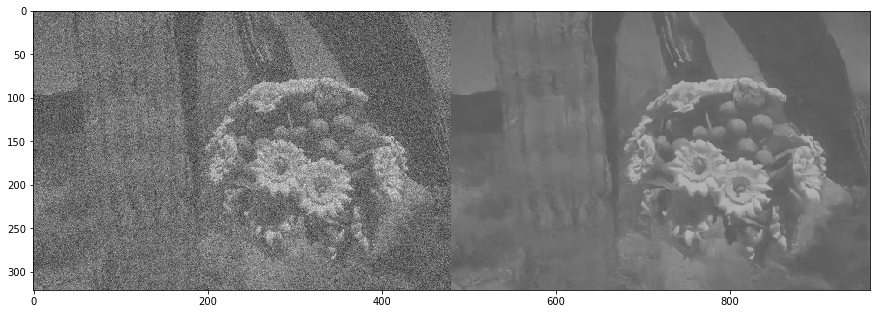

     Set68 : test067.png : 0.0634 second


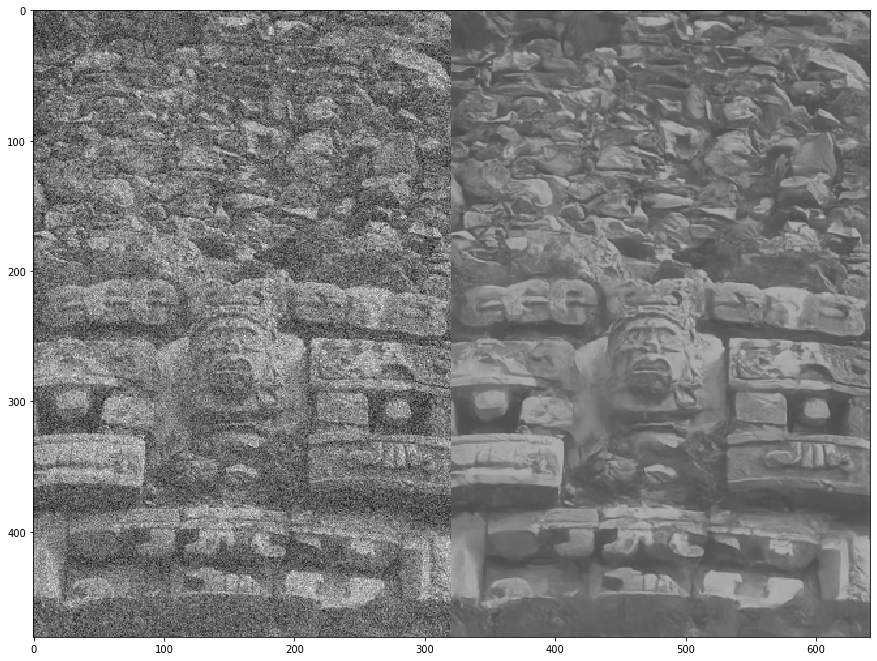

     Set68 : test056.png : 0.0616 second


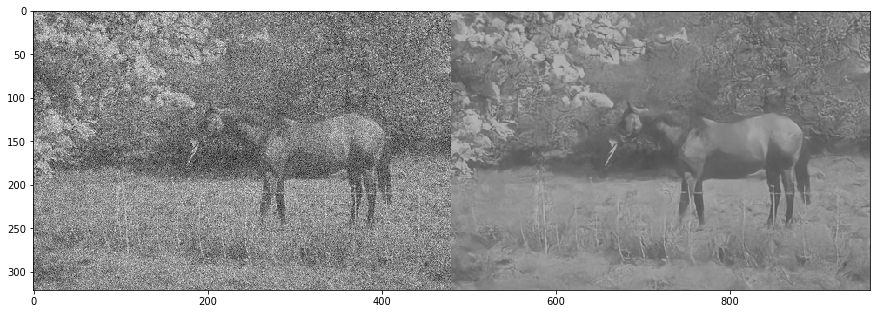

     Set68 : test039.png : 0.0612 second


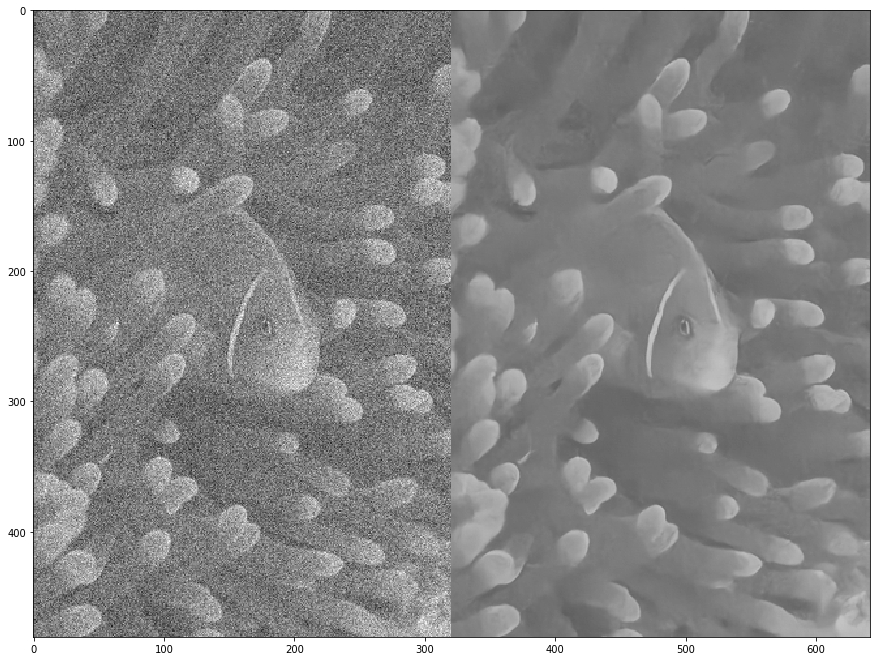

     Set68 : test040.png : 0.0622 second


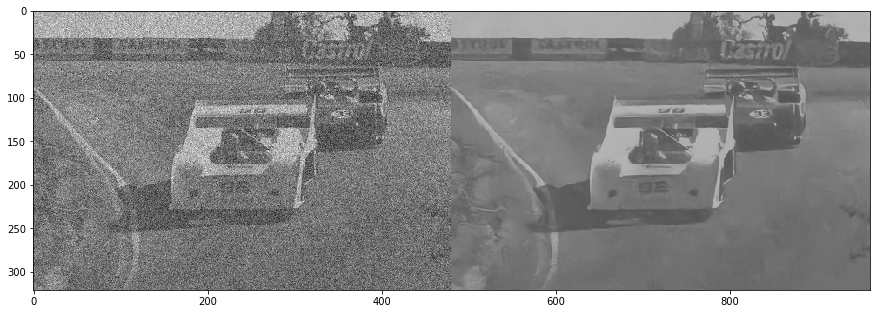

     Set68 : test014.png : 0.0609 second


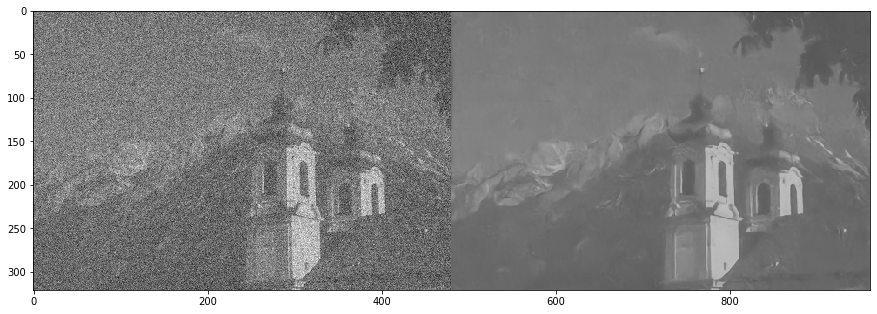

     Set68 : test011.png : 0.0606 second


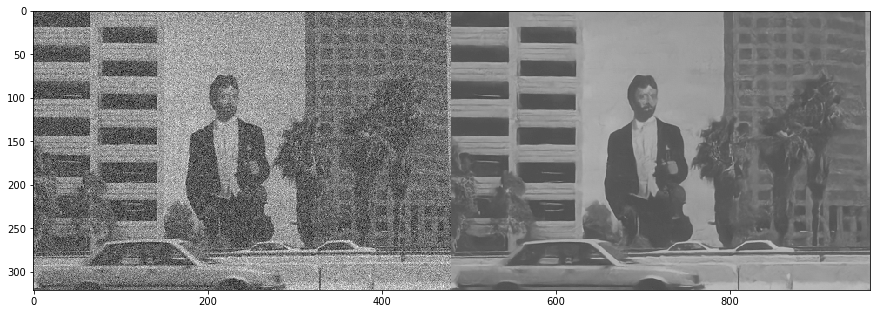

     Set68 : test024.png : 0.0604 second


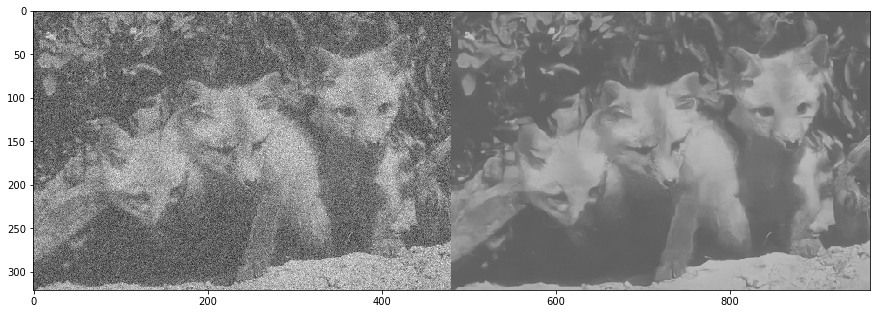

     Set68 : test023.png : 0.0607 second


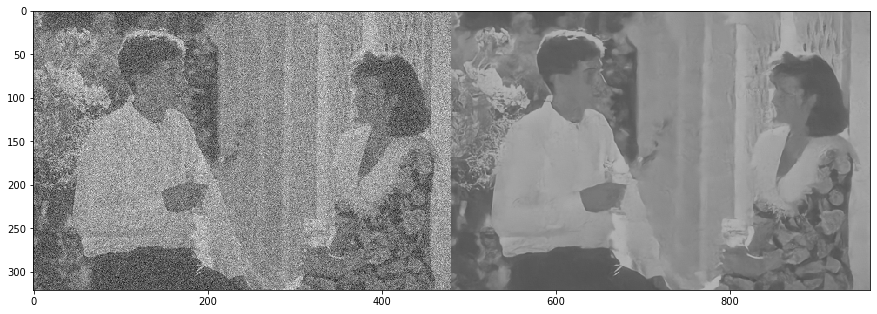

     Set68 : test033.png : 0.0602 second


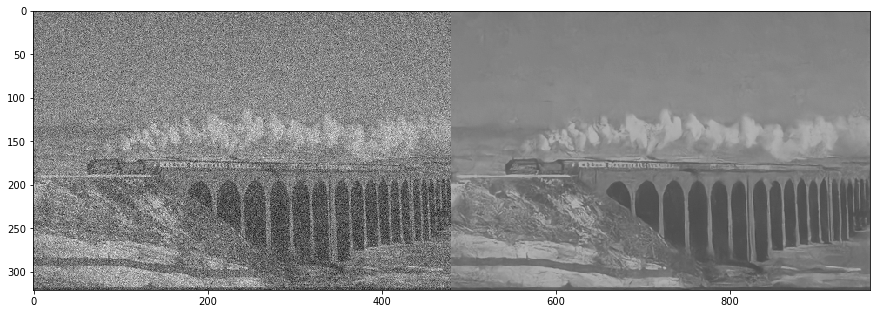

     Set68 : test054.png : 0.0607 second


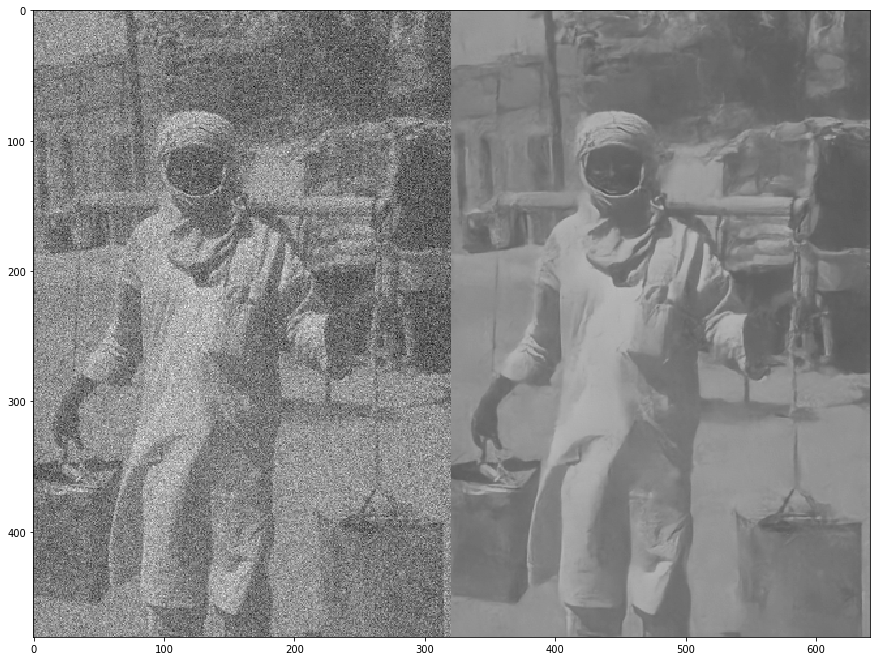

     Set68 : test068.png : 0.0603 second


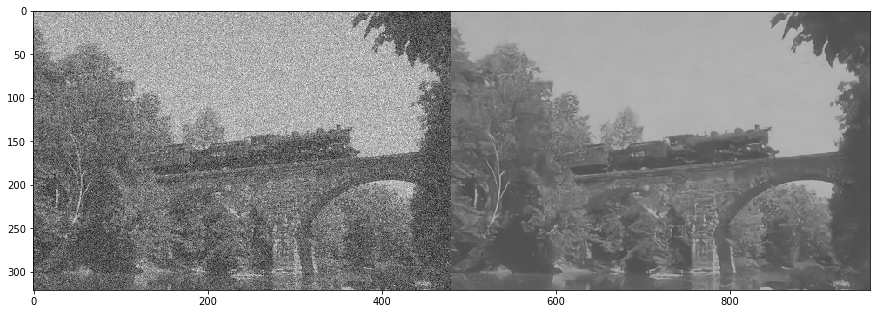

     Set68 : test041.png : 0.0610 second


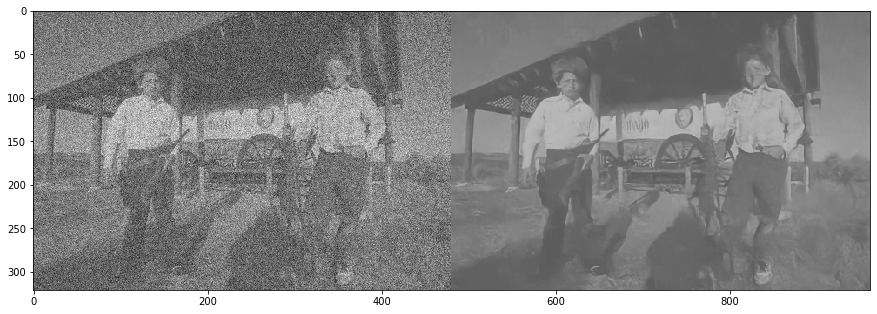

     Set68 : test020.png : 0.0610 second


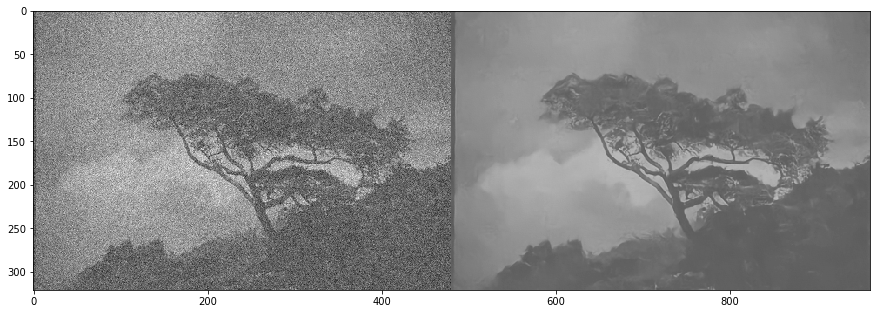

     Set68 : test055.png : 0.0607 second


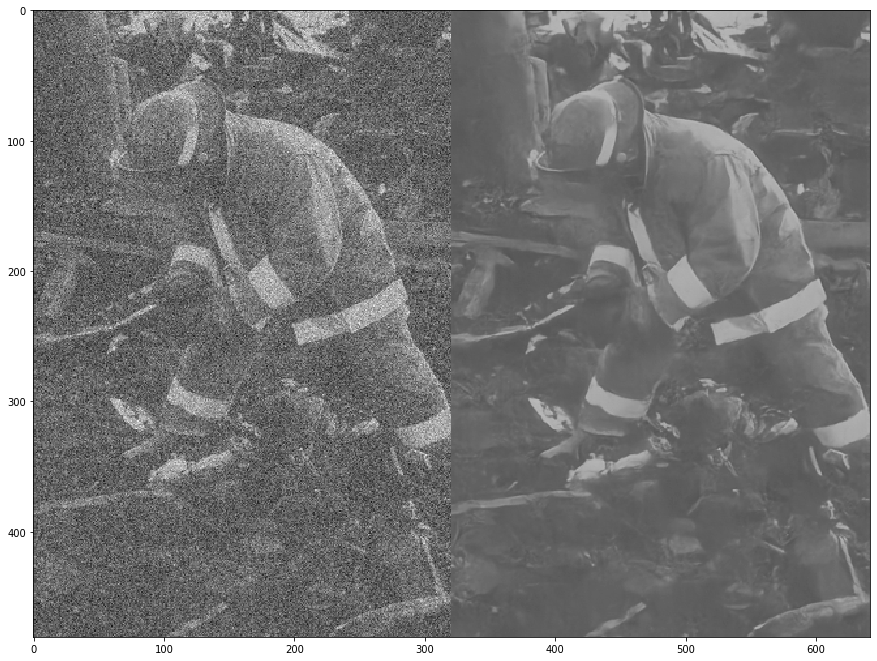

     Set68 : test018.png : 0.0612 second


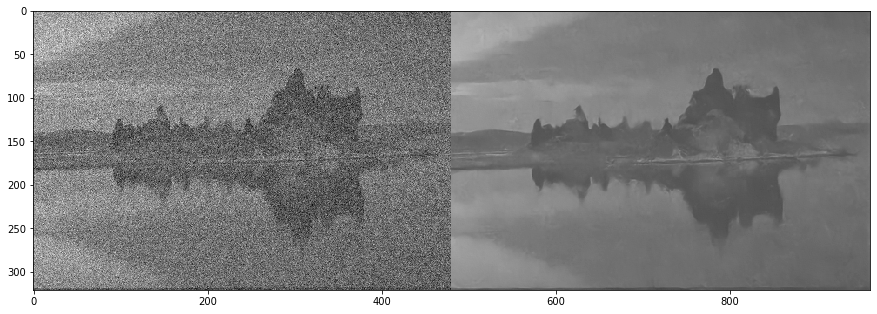

     Set68 : test050.png : 0.0619 second


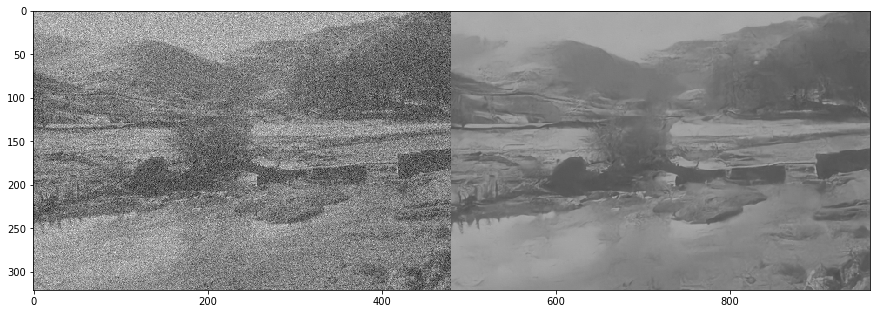

     Set68 : test043.png : 0.0608 second


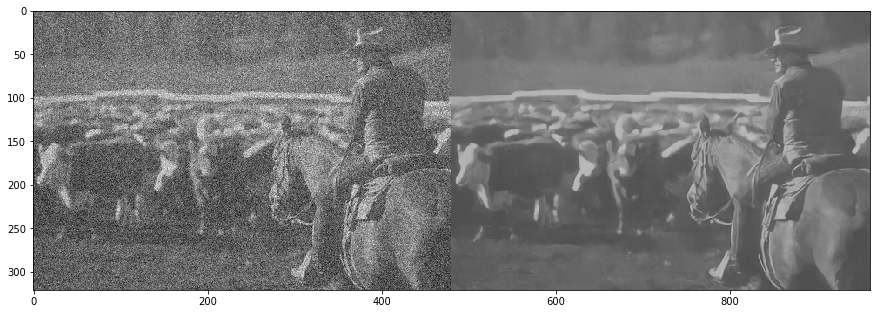

     Set68 : test066.png : 0.0610 second


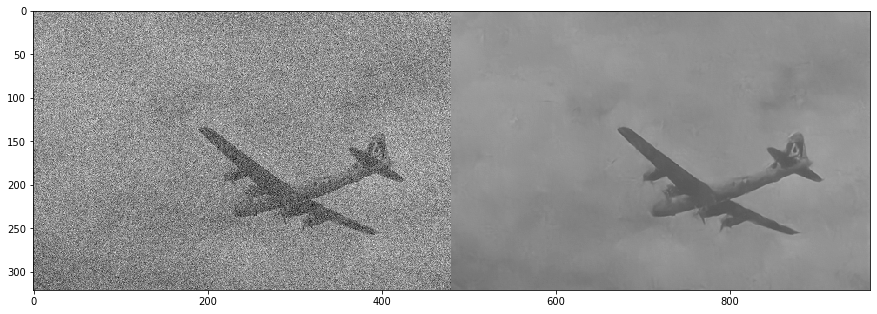

     Set68 : test057.png : 0.0833 second


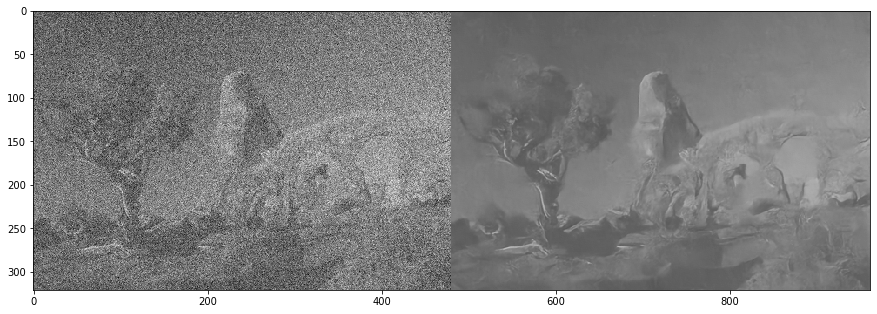

     Set68 : test029.png : 0.0621 second


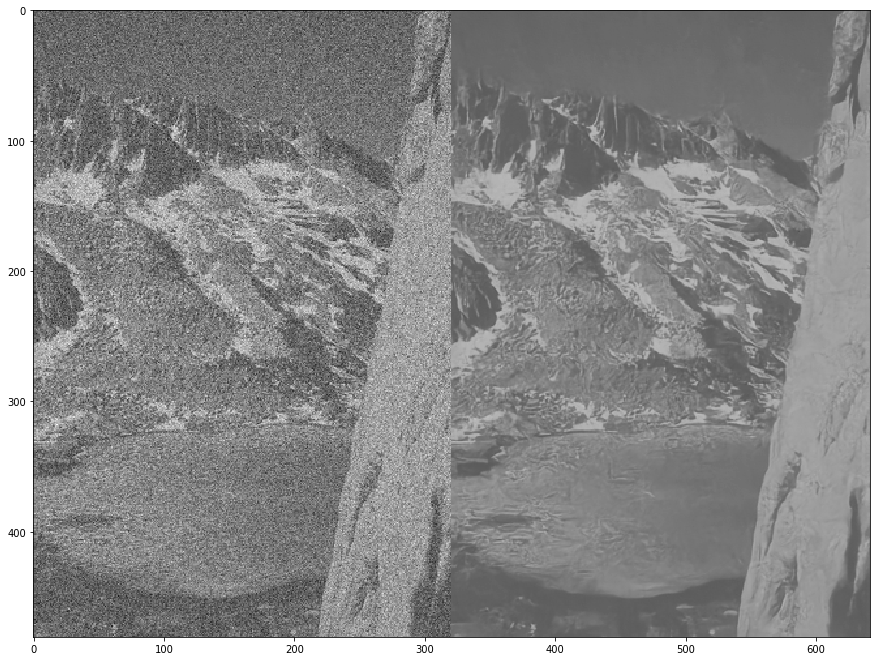

     Set68 : test044.png : 0.0605 second


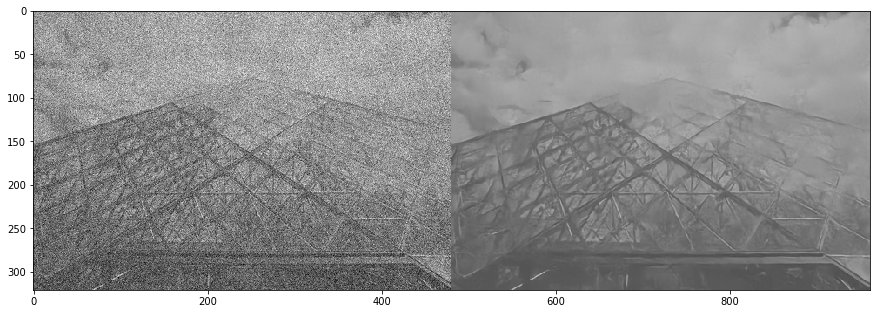

     Set68 : test053.png : 0.0617 second


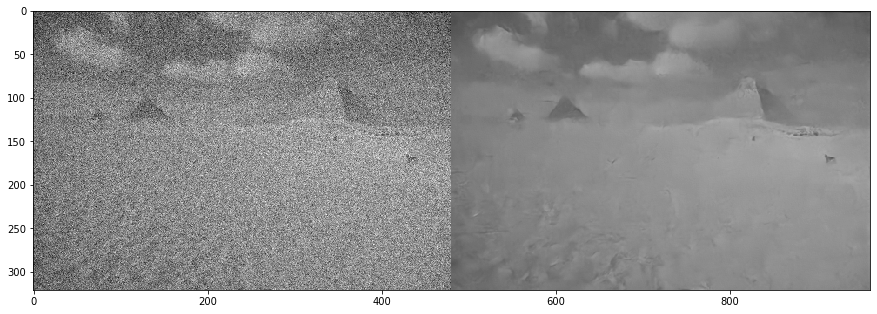

     Set68 : test007.png : 0.0609 second


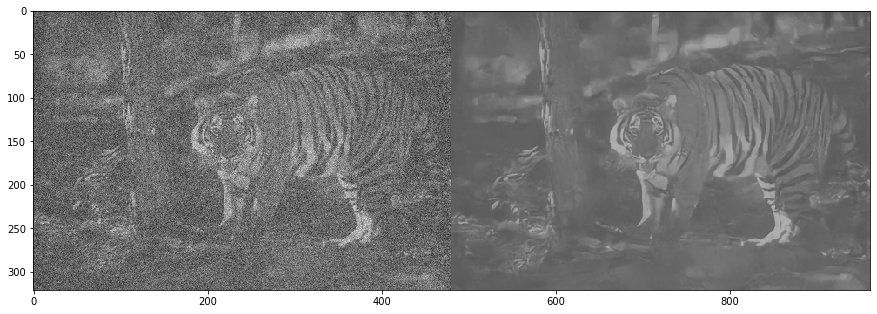

     Set68 : test065.png : 0.0619 second


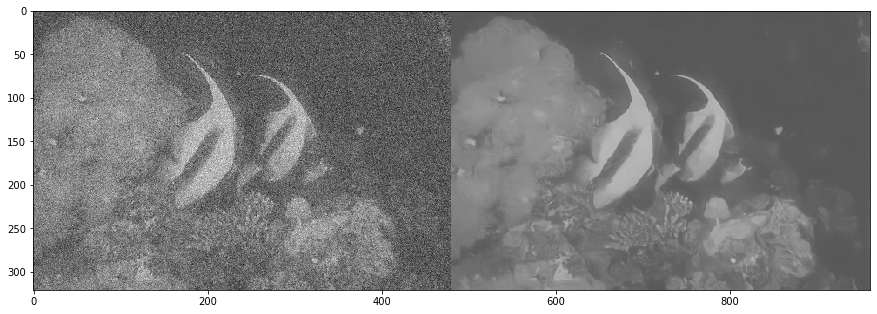

     Set68 : test047.png : 0.0608 second


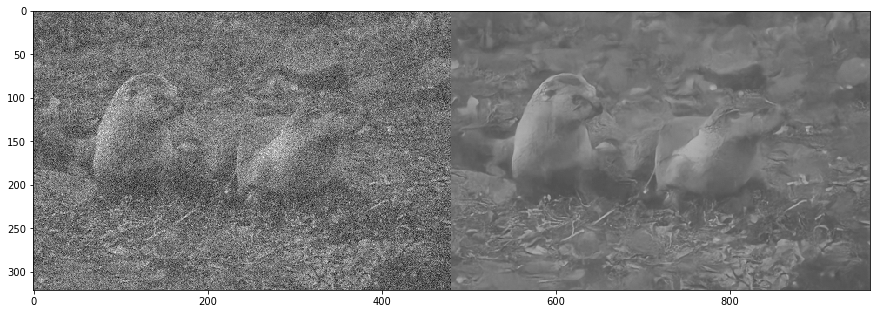

     Set68 : test019.png : 0.0609 second


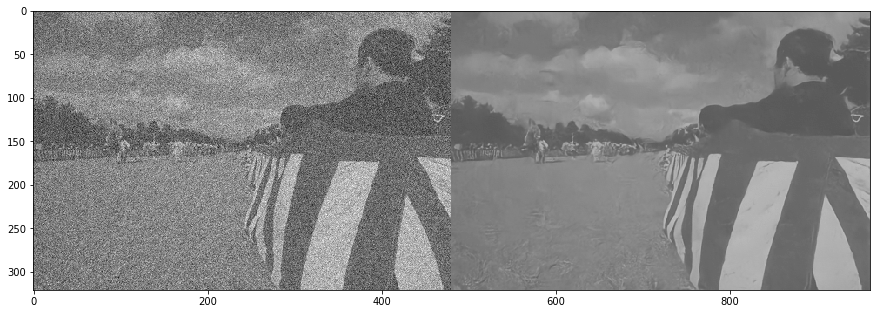

     Set68 : test030.png : 0.0617 second


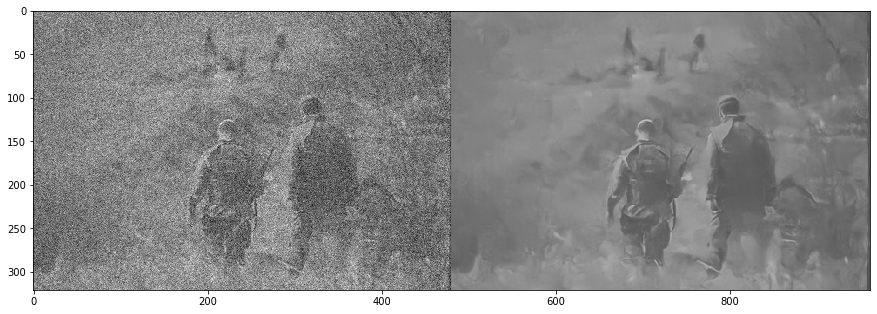

     Set68 : test026.png : 0.0613 second


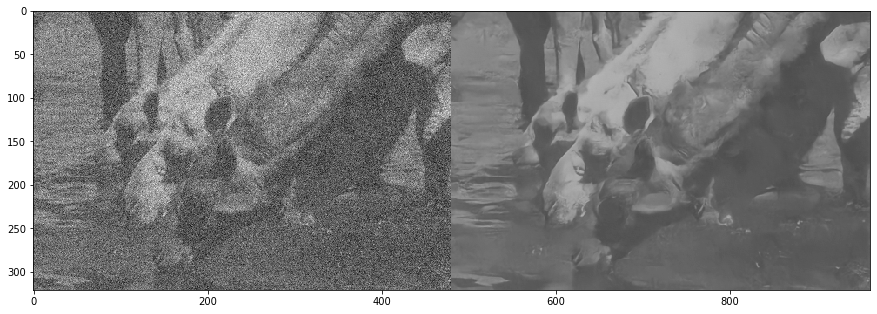

     Set68 : test051.png : 0.0609 second


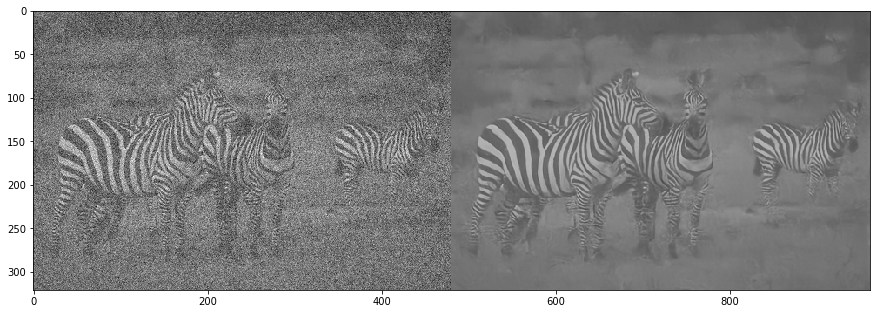

     Set68 : test013.png : 0.0603 second


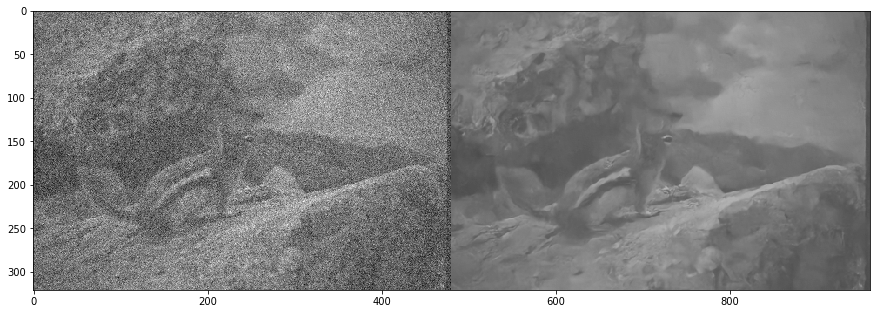

     Set68 : test015.png : 0.0612 second


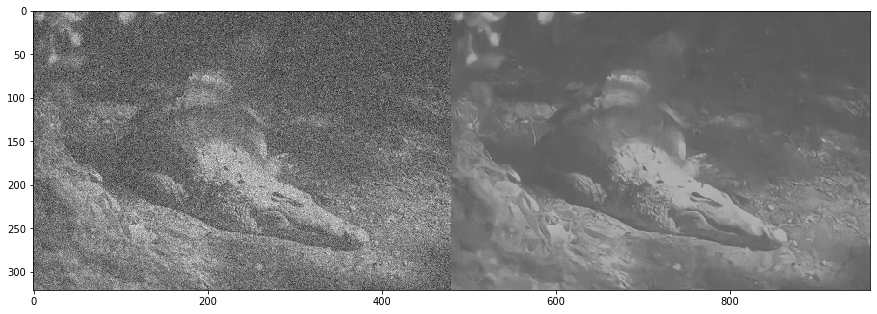

     Set68 : test037.png : 0.0606 second


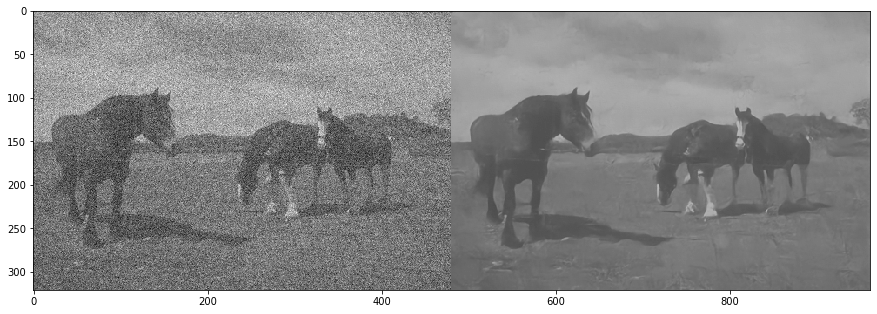

     Set68 : test036.png : 0.0624 second


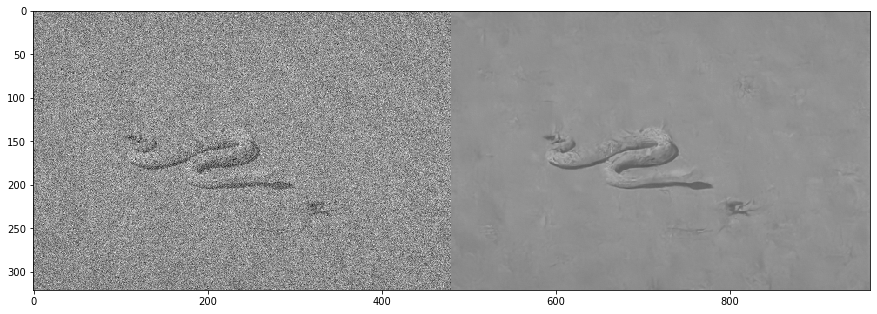

     Set68 : test058.png : 0.0623 second


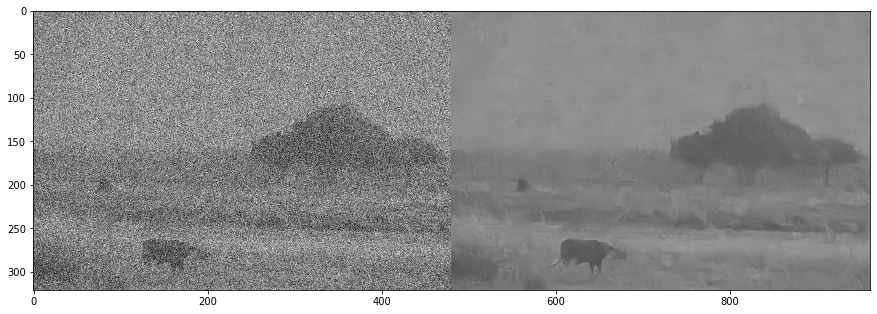

     Set68 : test001.png : 0.2975 second


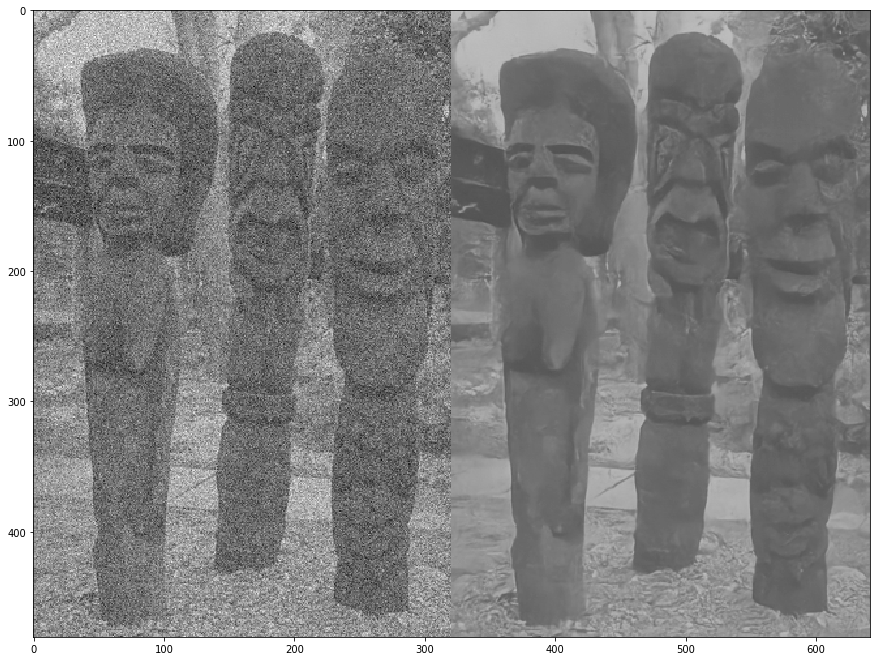

     Set68 : test042.png : 0.0635 second


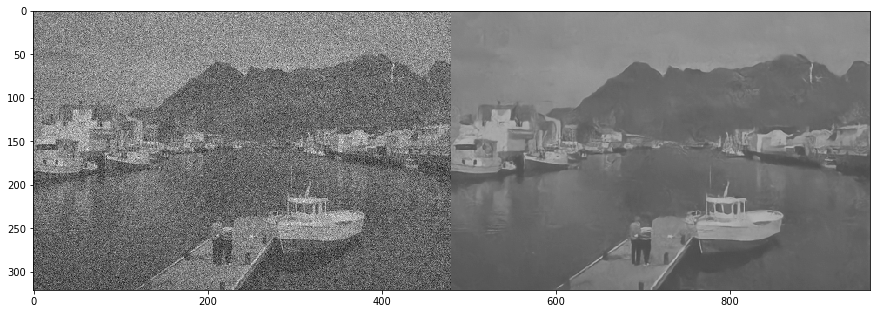

     Set68 : test016.png : 0.0627 second


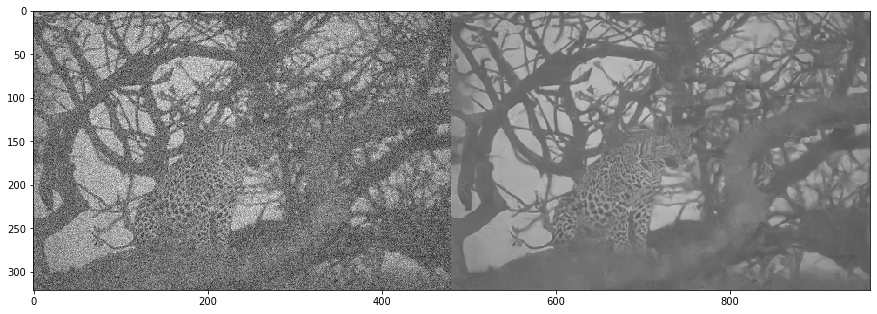

     Set68 : test004.png : 0.0628 second


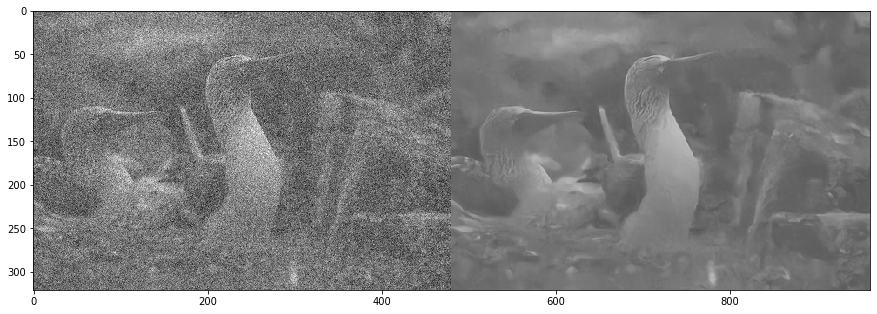

     Set68 : test022.png : 0.0634 second


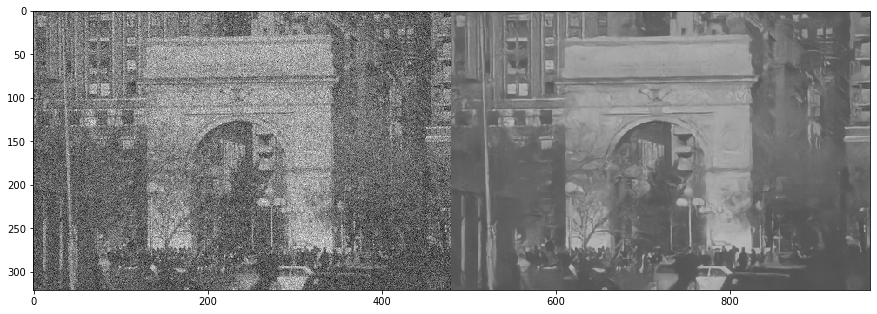

     Set68 : test063.png : 0.0874 second


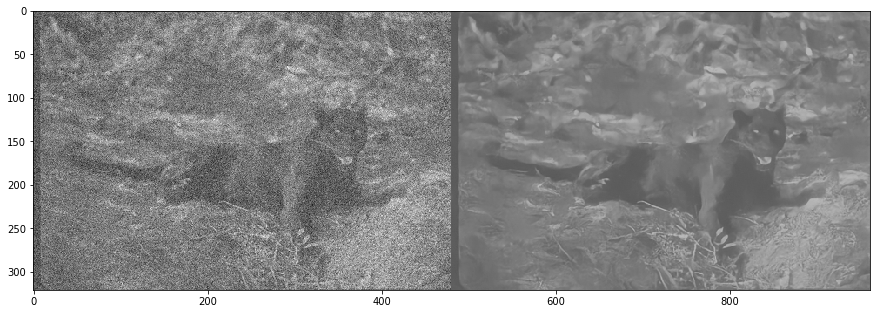

     Set68 : test059.png : 0.0939 second


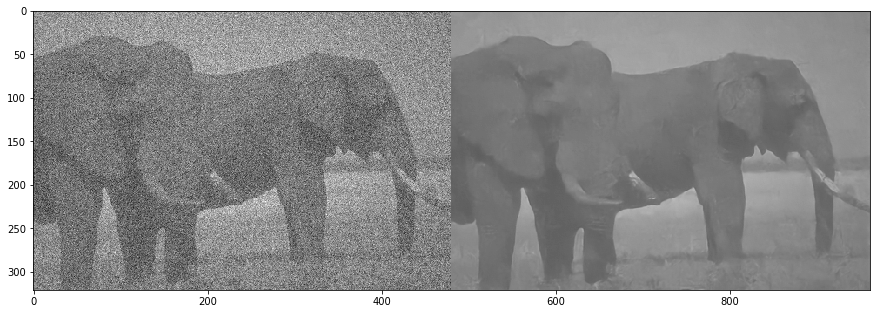

     Set68 : test061.png : 0.0809 second


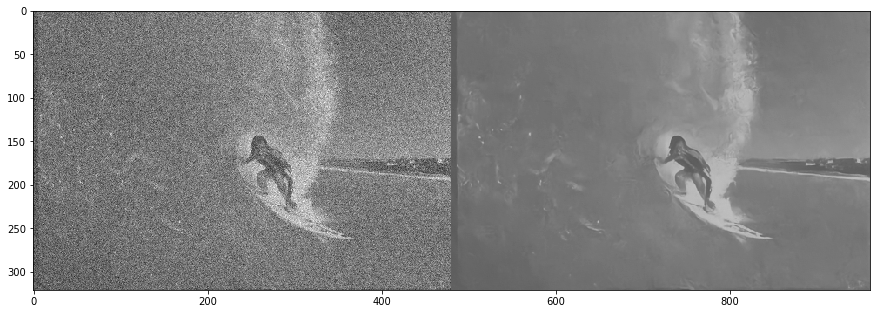

     Set68 : test005.png : 0.0914 second


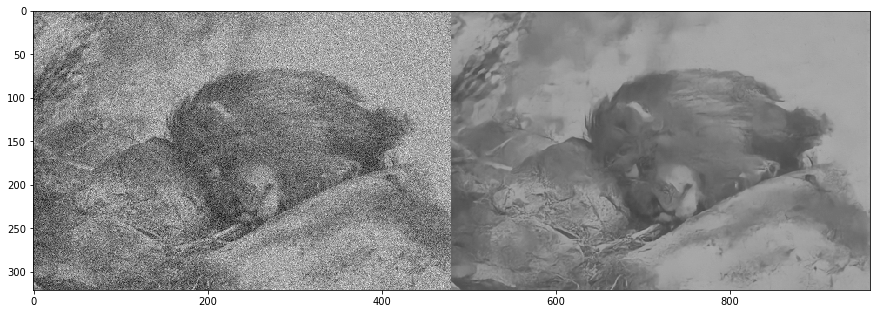

     Set68 : test064.png : 0.0643 second


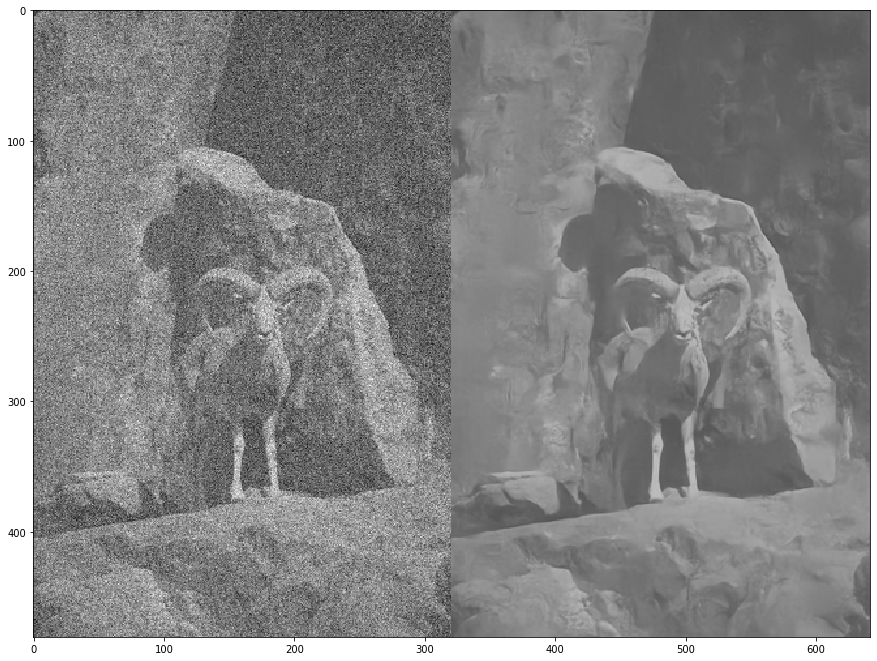

     Set68 : test038.png : 0.0653 second


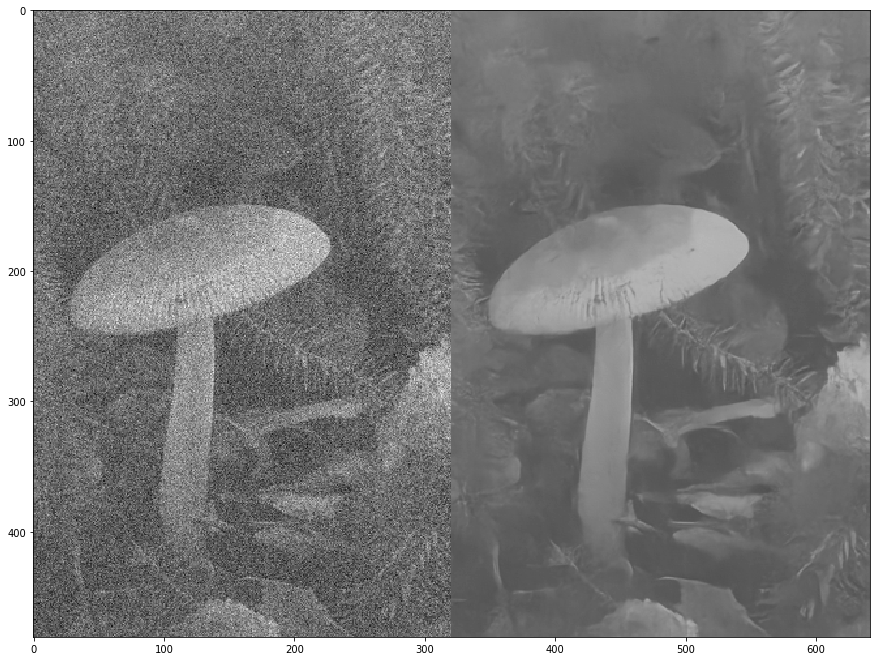

     Set68 : test048.png : 0.0614 second


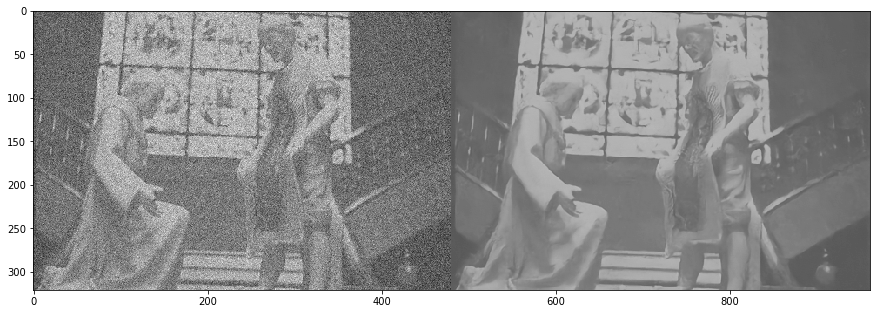

     Set68 : test046.png : 0.0613 second


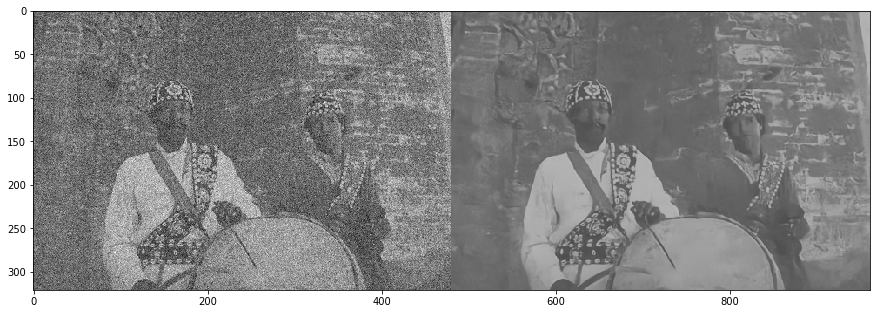

     Set68 : test008.png : 0.0616 second


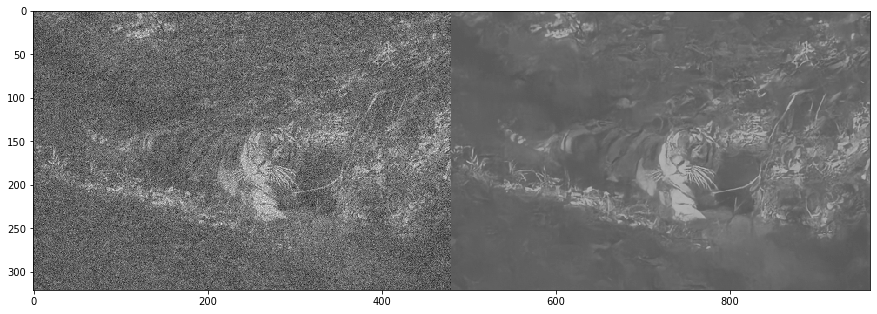

     Set68 : test003.png : 0.0618 second


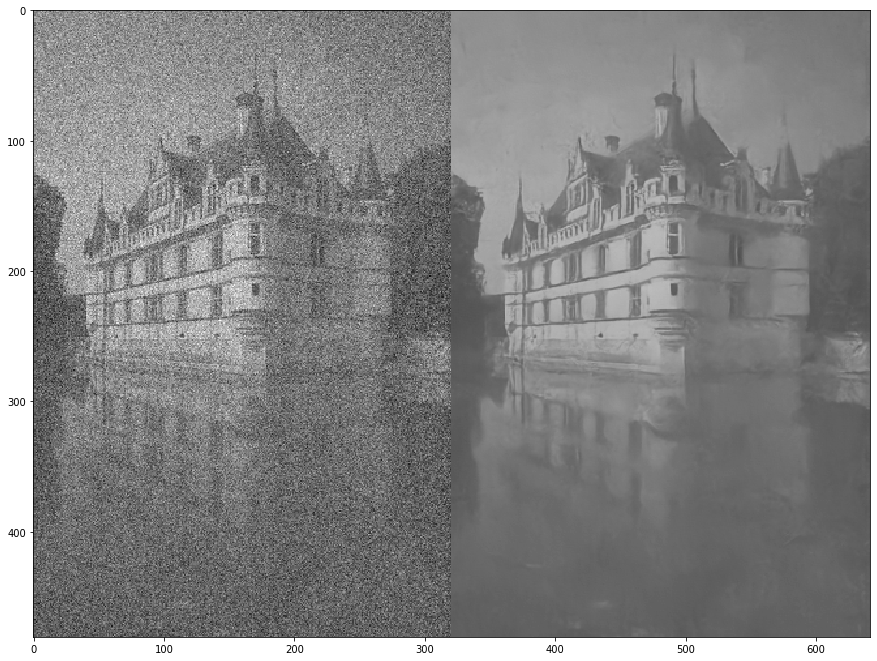

     Set68 : test028.png : 0.0620 second


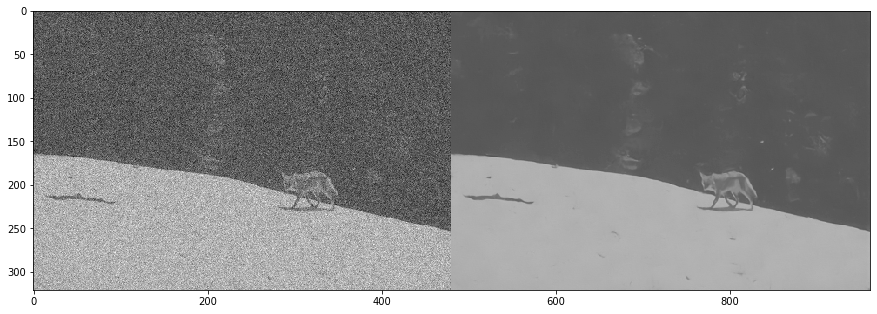

2021-05-08 08:07:30: Datset: Set68      
  PSNR = 25.92dB, SSIM = 0.8150
     Set12 :     11.png : 0.4047 second


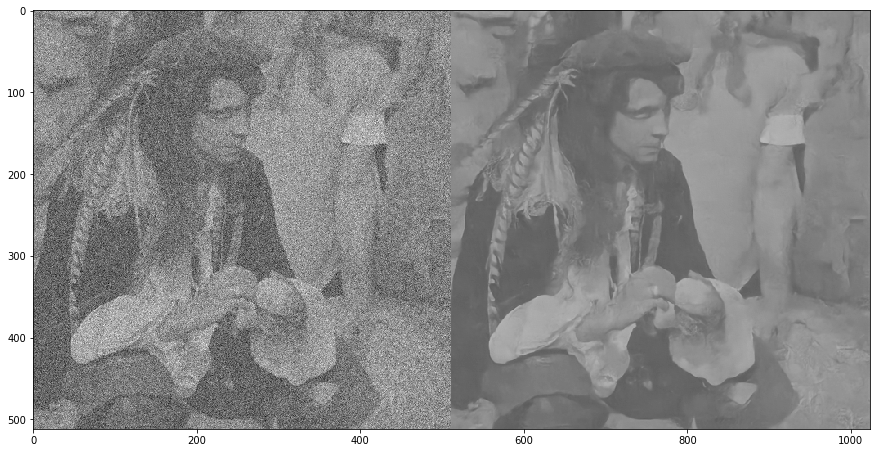

     Set12 :     03.png : 0.0864 second


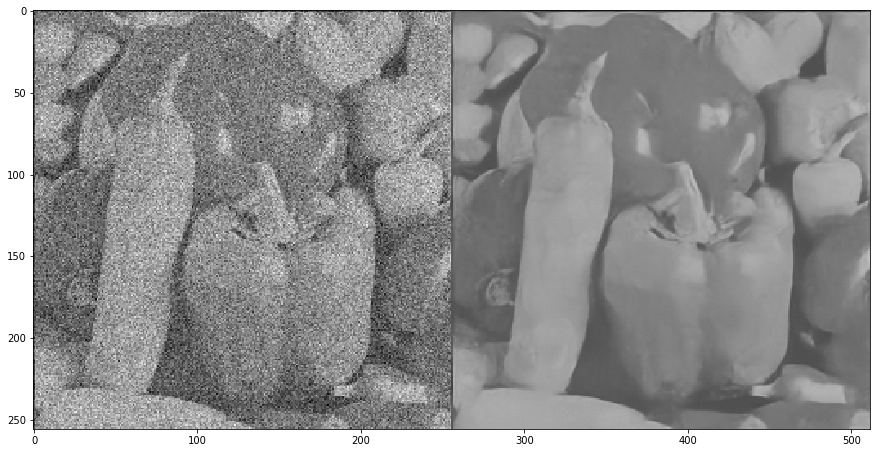

     Set12 :     09.png : 0.0703 second


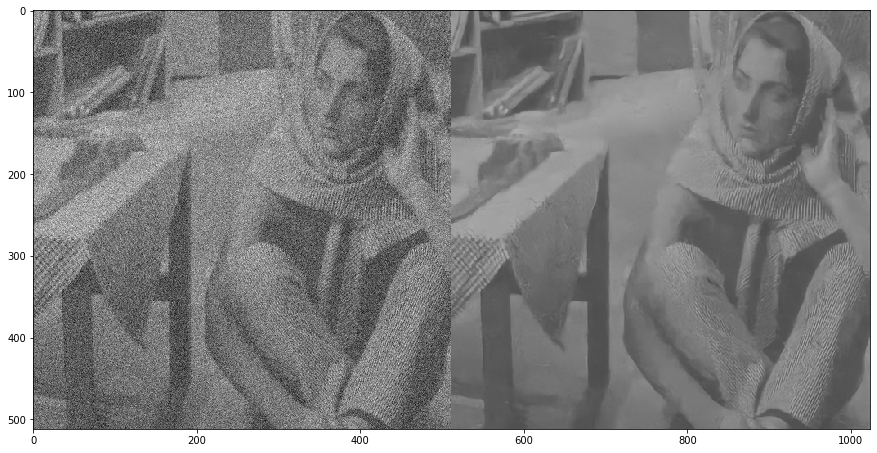

     Set12 :     02.png : 0.0501 second


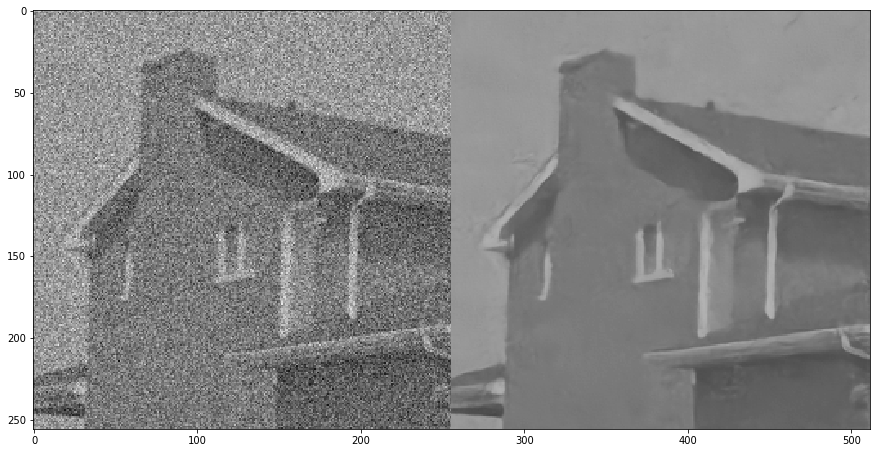

     Set12 :     08.png : 0.0710 second


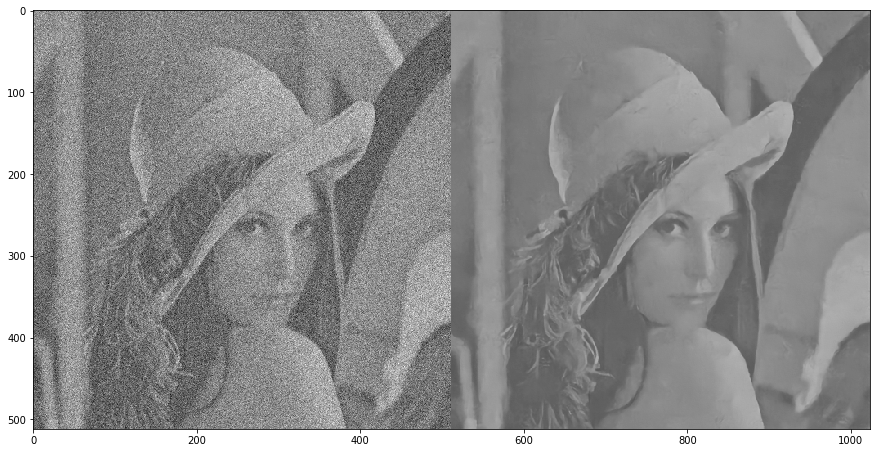

     Set12 :     10.png : 0.0711 second


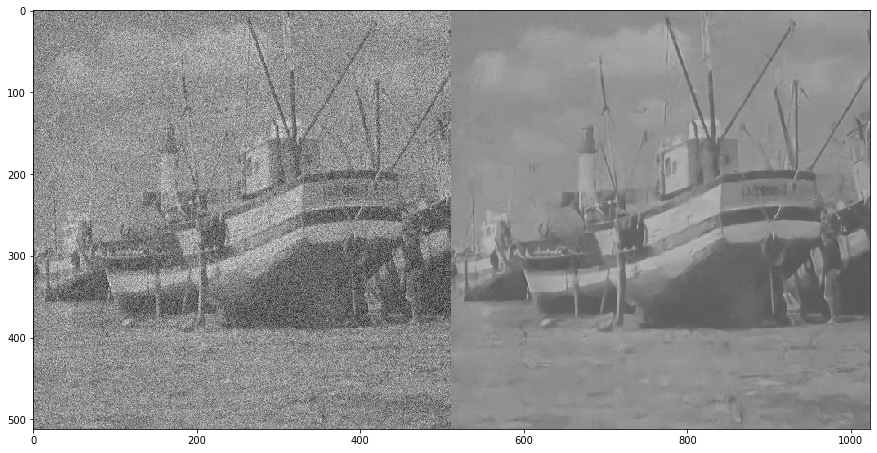

     Set12 :     06.png : 0.0505 second


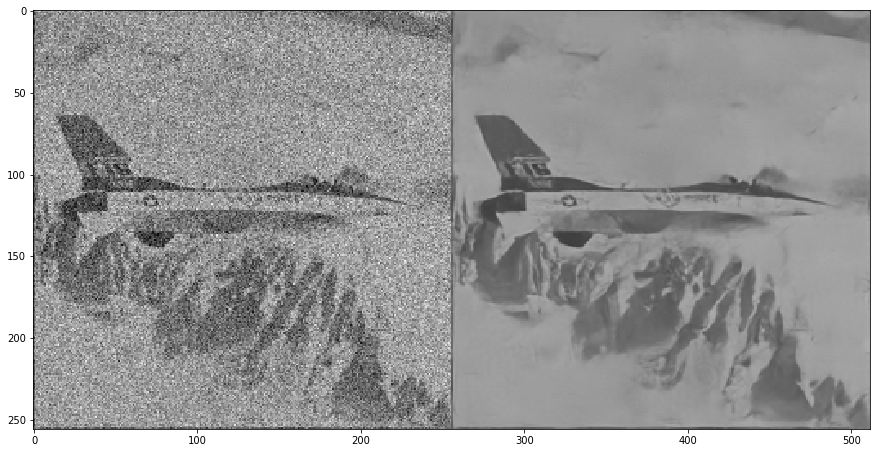

     Set12 :     12.png : 0.0707 second


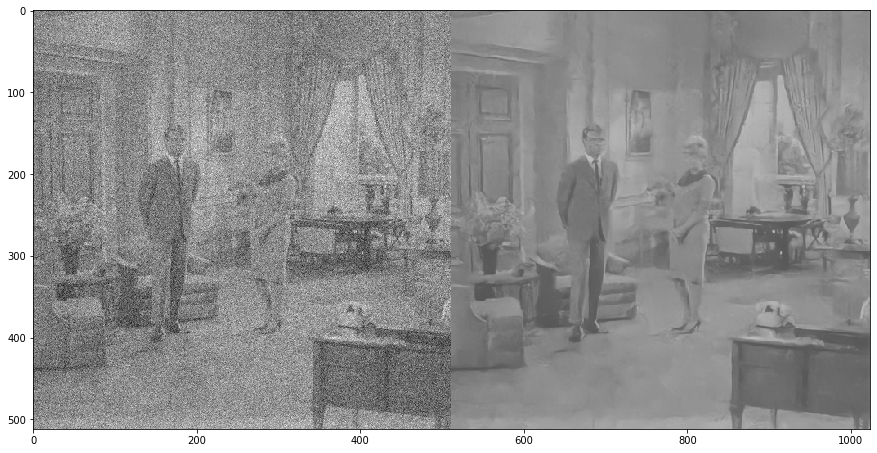

     Set12 :     01.png : 0.0504 second


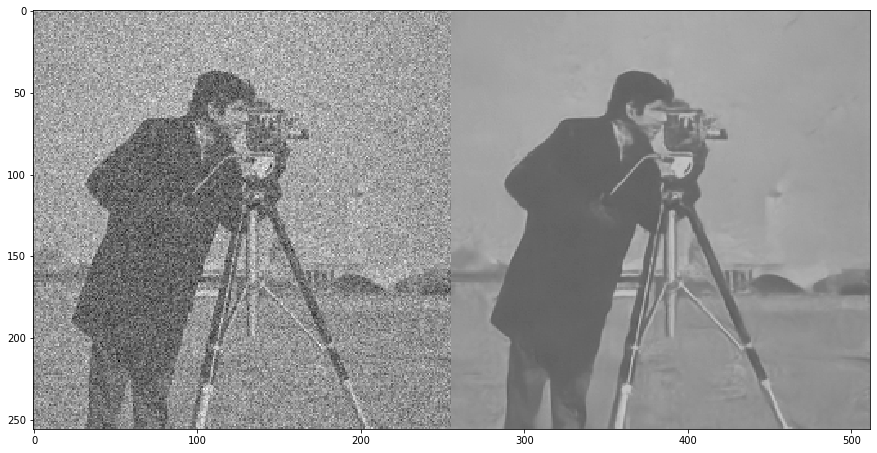

     Set12 :     07.png : 0.0490 second


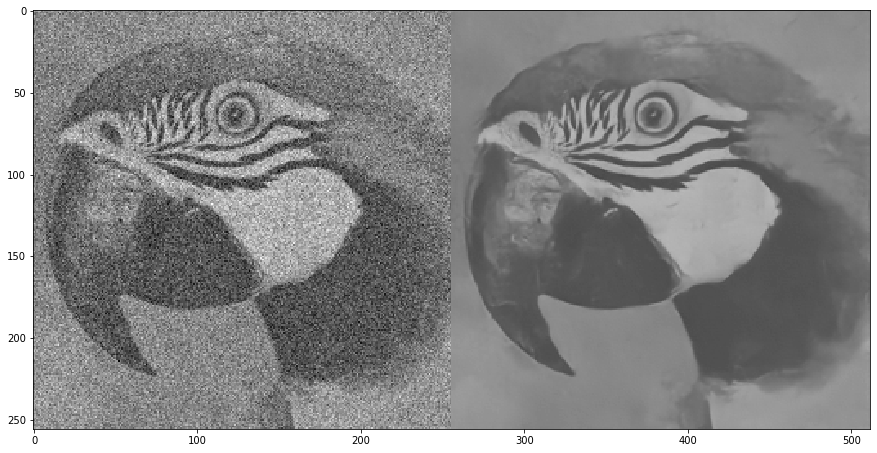

     Set12 :     04.png : 0.0491 second


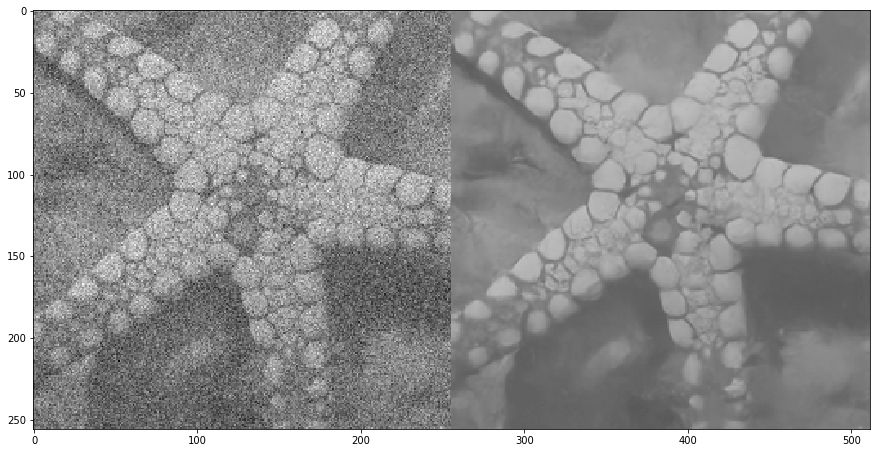

     Set12 :     05.png : 0.0494 second


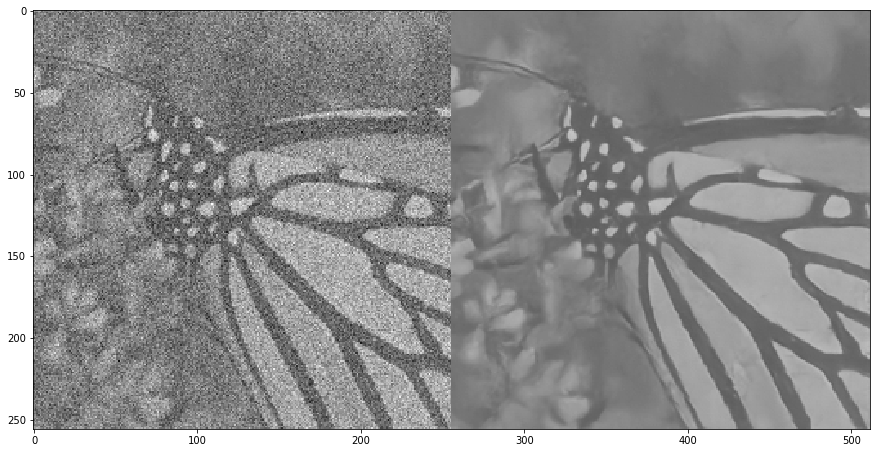

2021-05-08 08:07:36: Datset: Set12      
  PSNR = 26.63dB, SSIM = 0.8608


In [ ]:
def parse_args():
    parser = argparse.ArgumentParser()
    parser.add_argument('--set_dir', default='../input/image-data/Test/Test', type=str, help='directory of test dataset')
    parser.add_argument('--set_names', default=['Set68','Set12'], type=list, help='name of test dataset')
    parser.add_argument('--sigma', default=50, type=int, help='noise level')
    parser.add_argument('--model_dir', default='./models/DnCNN_sigma50/', type=str, help='directory of the model')
    parser.add_argument('--model_name', default='model_006.hdf5', type=str, help='the model name')
    parser.add_argument('--result_dir', default='./results', type=str, help='directory of results')
    parser.add_argument('--save_result', default=1, type=int, help='save the denoised image, 1 or 0')
    return parser.parse_args(args = [])
    
def to_tensor(img):
    if img.ndim == 2:
        return img[np.newaxis,...,np.newaxis]
    elif img.ndim == 3:
        return np.moveaxis(img,2,0)[...,np.newaxis]

def from_tensor(img):
    return np.squeeze(np.moveaxis(img[...,0],0,-1))

def log(*args,**kwargs):
     print(datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S:"),*args,**kwargs)

def save_result(result,path):
    path = path if path.find('.') != -1 else path+'.png'
    ext = os.path.splitext(path)[-1]
    if ext in ('.txt','.dlm'):
        np.savetxt(path,result,fmt='%2.4f')
    else:
        imsave(path,np.clip(result,0,1))


def show(x,title=None,cbar=False,figsize=None):
    import matplotlib.pyplot as plt
    plt.figure(figsize=figsize)
    plt.imshow(x,interpolation='nearest',cmap='gray')
    if title:
        plt.title(title)
    if cbar:
        plt.colorbar()
    plt.show()



args = parse_args()


# =============================================================================
#     # serialize model to JSON
#     model_json = model.to_json()
#     with open("model.json", "w") as json_file:
#         json_file.write(model_json)
#     # serialize weights to HDF5
#     model.save_weights("model.h5")
#     print("Saved model")
# =============================================================================

if not os.path.exists(os.path.join(args.model_dir, args.model_name)):
    # load json and create model
    json_file = open(os.path.join(args.model_dir,'model.json'), 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    model = model_from_json(loaded_model_json)
    # load weights into new model
    model.load_weights(os.path.join(args.model_dir,'model.h5'))
    log('load trained model on Train400 dataset by kai')
else:
    model = load_model(os.path.join(args.model_dir, args.model_name),compile=False)
    log('load trained model')

if not os.path.exists(args.result_dir):
    os.mkdir(args.result_dir)

for set_cur in args.set_names:  

    if not os.path.exists(os.path.join(args.result_dir,set_cur)):
        os.mkdir(os.path.join(args.result_dir,set_cur))
    psnrs = []
    ssims = [] 

    for im in os.listdir(os.path.join(args.set_dir,set_cur)): 
        if im.endswith(".jpg") or im.endswith(".bmp") or im.endswith(".png"):
            #x = np.array(Image.open(os.path.join(args.set_dir,set_cur,im)), dtype='float32') / 255.0
            x = np.array(imread(os.path.join(args.set_dir,set_cur,im)), dtype=np.float32) / 255.0
            np.random.seed(seed=0) # for reproducibility
            y = x + np.random.normal(0, args.sigma/255.0, x.shape) # Add Gaussian noise without clipping
            y = y.astype(np.float32)
            y_  = to_tensor(y)
            start_time = time.time()
            x_ = model.predict(y_) # inference
            elapsed_time = time.time() - start_time
            print('%10s : %10s : %2.4f second'%(set_cur,im,elapsed_time))
            x_=from_tensor(x_)
            psnr_x_ = peak_signal_noise_ratio(x, x_)
            ssim_x_ = structural_similarity(x, x_)
            if args.save_result:
                name, ext = os.path.splitext(im)
                show(np.hstack((y,x_)),figsize=(15,20)) # show the image
                save_result(x_,path=os.path.join(args.result_dir,set_cur,name+'_dncnn'+ext)) # save the denoised image
            psnrs.append(psnr_x_)
            ssims.append(ssim_x_)

    psnr_avg = np.mean(psnrs)
    ssim_avg = np.mean(ssims)
    psnrs.append(psnr_avg)
    ssims.append(ssim_avg)

    if args.save_result:
        save_result(np.hstack((psnrs,ssims)),path=os.path.join(args.result_dir,set_cur,'results.txt'))

    log('Datset: {0:10s} \n  PSNR = {1:2.2f}dB, SSIM = {2:1.4f}'.format(set_cur, psnr_avg, ssim_avg))        

In [ ]:
import os
os.remove("./aip_denoise.tar.gz")

In [ ]:
!tar -zcvf aip_denoise.tar.gz /kaggle/working

tar: Removing leading `/' from member names
/kaggle/working/
/kaggle/working/results/
/kaggle/working/results/Set12/
/kaggle/working/results/Set12/03_dncnn.png
/kaggle/working/results/Set12/11_dncnn.png
/kaggle/working/results/Set12/04_dncnn.png
/kaggle/working/results/Set12/07_dncnn.png
/kaggle/working/results/Set12/05_dncnn.png
/kaggle/working/results/Set12/12_dncnn.png
/kaggle/working/results/Set12/06_dncnn.png
/kaggle/working/results/Set12/02_dncnn.png
/kaggle/working/results/Set12/10_dncnn.png
/kaggle/working/results/Set12/01_dncnn.png
/kaggle/working/results/Set12/09_dncnn.png
/kaggle/working/results/Set12/08_dncnn.png
/kaggle/working/results/Set12/results.txt
/kaggle/working/results/Set68/
/kaggle/working/results/Set68/test051_dncnn.png
/kaggle/working/results/Set68/test060_dncnn.png
/kaggle/working/results/Set68/test010_dncnn.png
/kaggle/working/results/Set68/test048_dncnn.png
/kaggle/working/results/Set68/test006_dncnn.png
/kaggle/working/results/Set68/test018_dncnn.png
/kaggl